# PART 1. DATA PREPARATION

## 1.1. Mount Google Drive & import libraries

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
import seaborn as sns

## 1.2. Handling table "measurement_info"

In [3]:
measurement_info = pd.read_csv('/content/drive/MyDrive/AirPollutionSeoul/Original Data/Measurement_info.csv')
measurement_info

,Measurement date,Station code,Item code,Average value,Instrument status
0,2017-01-01 00:00,101,1,0.004,0
1,2017-01-01 00:00,101,3,0.059,0
2,2017-01-01 00:00,101,5,1.200,0
3,2017-01-01 00:00,101,6,0.002,0
4,2017-01-01 00:00,101,8,73.000,0
...,...,...,...,...,...
3885061,2019-12-31 23:00,123,9,13.000,0
3885062,2019-12-31 23:00,118,9,24.000,0
3885063,2019-12-31 23:00,105,8,19.000,0
3885064,2019-12-31 23:00,125,3,0.037,0


In [4]:
measurement_info.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3885066 entries, 0 to 3885065
Data columns (total 5 columns):
 #   Column             Dtype  
---  ------             -----  
 0   Measurement date   object 
 1   Station code       int64  
 2   Item code          int64  
 3   Average value      float64
 4   Instrument status  int64  
dtypes: float64(1), int64(3), object(1)
memory usage: 148.2+ MB


In [5]:
# convert "Measurement date" datatype to datetime for easier filtering
measurement_info['Measurement date'] = pd.to_datetime(measurement_info['Measurement date'])

In [6]:
# Quick check
print('Total missing values for each column:')
measurement_info.isnull().sum()

Total missing values for each column:


,0
Measurement date,0
Station code,0
Item code,0
Average value,0
Instrument status,0


In [7]:
print('Total duplicate rows:')
measurement_info.duplicated().sum()

Total duplicate rows:


np.int64(0)

In [8]:
print('Distinct values for Item code:', measurement_info['Item code'].unique())
print('Distinct values for Station code:', measurement_info['Station code'].unique())

Distinct values for Item code: [1 3 5 6 8 9]
Distinct values for Station code: [101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118
 119 120 121 122 123 124 125]


## 1.3. Handling table "measurement_station_info"

In [9]:
measurement_station_info = pd.read_csv('/content/drive/MyDrive/AirPollutionSeoul/Original Data//Measurement_station_info.csv')
measurement_station_info

,Station code,Station name(district),Address,Latitude,Longitude
0,101,Jongno-gu,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008
1,102,Jung-gu,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",37.564263,126.974676
2,103,Yongsan-gu,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",37.540033,127.004850
3,104,Eunpyeong-gu,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848
4,105,Seodaemun-gu,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",37.593742,126.949679
5,106,Mapo-gu,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597
6,107,Seongdong-gu,"18, Ttukseom-ro 3-gil, Seongdong-gu, Seoul, Re...",37.541864,127.049659
7,108,Gwangjin-gu,"571, Gwangnaru-ro, Gwangjin-gu, Seoul, Republi...",37.547180,127.092493
8,109,Dongdaemun-gu,"43, Cheonho-daero 13-gil, Dongdaemun-gu, Seoul...",37.575743,127.028885
9,110,Jungnang-gu,"369, Yongmasan-ro, Jungnang-gu, Seoul, Republi...",37.584848,127.094023


In [10]:
# examine general info
measurement_station_info.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 5 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   Station code            25 non-null     int64  
 1   Station name(district)  25 non-null     object 
 2   Address                 25 non-null     object 
 3   Latitude                25 non-null     float64
 4   Longitude               25 non-null     float64
dtypes: float64(2), int64(1), object(2)
memory usage: 1.1+ KB


In [11]:
# check total null rows
measurement_station_info.isnull().sum()

,0
Station code,0
Station name(district),0
Address,0
Latitude,0
Longitude,0


In [12]:
measurement_station_info.duplicated().sum()

np.int64(0)

In [13]:
## Clean text fields
# replace suffix "-gu" for column "Station name"
measurement_station_info['Station name(district)'] = measurement_station_info['Station name(district)'].str.replace(r'-gu$', '', regex=True).str.strip()

# replace suffix "-gu" with "District", "Republic of Korea" -> "South Korea" for column "Address"
measurement_station_info["Address"] = (measurement_station_info["Address"]
    .str.replace("-gu", " District", regex=False)
    .str.replace("Republic of Korea", "South Korea", regex=False)
)

In [14]:
# round up Latitude, Longtitude to 4 decimal points
measurement_station_info['Latitude'] = measurement_station_info['Latitude'].round(4)
measurement_station_info['Longitude'] = measurement_station_info['Longitude'].round(4)

In [15]:
# check after modifying
measurement_station_info

,Station code,Station name(district),Address,Latitude,Longitude
0,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050
1,102,Jung,"15, Deoksugung-gil, Jung District, Seoul, Sout...",37.5643,126.9747
2,103,Yongsan,"136, Hannam-daero, Yongsan District, Seoul, So...",37.5400,127.0048
3,104,Eunpyeong,"215, Jinheung-ro, Eunpyeong District, Seoul, S...",37.6098,126.9348
4,105,Seodaemun,"32, Segeomjeong-ro 4-gil, Seodaemun District, ...",37.5937,126.9497
5,106,Mapo,"10, Poeun-ro 6-gil, Mapo District, Seoul, Sout...",37.5556,126.9056
6,107,Seongdong,"18, Ttukseom-ro 3-gil, Seongdong District, Seo...",37.5419,127.0497
7,108,Gwangjin,"571, Gwangnaru-ro, Gwangjin District, Seoul, S...",37.5472,127.0925
8,109,Dongdaemun,"43, Cheonho-daero 13-gil, Dongdaemun District,...",37.5757,127.0289
9,110,Jungnang,"369, Yongmasan-ro, Jungnang District, Seoul, S...",37.5848,127.0940


## 1.4. Handling table "measurement_item_info"

In [16]:
measurement_item_info = pd.read_csv('/content/drive/MyDrive/AirPollutionSeoul/Original Data/Measurement_item_info.csv')
measurement_item_info

,Item code,Item name,Unit of measurement,Good(Blue),Normal(Green),Bad(Yellow),Very bad(Red)
0,1,SO2,ppm,0.02,0.05,0.15,1.0
1,3,NO2,ppm,0.03,0.06,0.20,2.0
2,5,CO,ppm,2.00,9.00,15.00,50.0
3,6,O3,ppm,0.03,0.09,0.15,0.5
4,8,PM10,Mircrogram/m3,30.00,80.00,150.00,600.0
5,9,PM2.5,Mircrogram/m3,15.00,35.00,75.00,500.0


In [17]:
# examine general info and data type
measurement_item_info.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6 entries, 0 to 5
Data columns (total 7 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Item code            6 non-null      int64  
 1   Item name            6 non-null      object 
 2   Unit of measurement  6 non-null      object 
 3   Good(Blue)           6 non-null      float64
 4   Normal(Green)        6 non-null      float64
 5   Bad(Yellow)          6 non-null      float64
 6   Very bad(Red)        6 non-null      float64
dtypes: float64(4), int64(1), object(2)
memory usage: 468.0+ bytes


In [18]:
# check total null rows
measurement_item_info.isnull().sum()

,0
Item code,0
Item name,0
Unit of measurement,0
Good(Blue),0
Normal(Green),0
Bad(Yellow),0
Very bad(Red),0


In [19]:
measurement_item_info.duplicated().sum()

np.int64(0)

In [20]:
# convert from wide to long format
measurement_item_info = measurement_item_info.melt(
    id_vars = ["Item code", "Item name", "Unit of measurement"],
    var_name = "Category",
    value_name = "Threshold"
)

In [21]:
# split category and color
measurement_item_info["Color"] = (
    measurement_item_info["Category"]
      .str.extract(r"\(([^()]+)\)", expand=False)
      .str.strip())
measurement_item_info["Category"] = (
    measurement_item_info["Category"]
      .str.extract(r"^([^()]+)", expand=False)
      .str.strip())

In [22]:
# re-arrage column order
measurement_item_info = measurement_item_info[["Item code", "Item name", "Unit of measurement", "Category", "Threshold", "Color"]]

# sort by "Item code"
measurement_item_info = measurement_item_info.sort_values(by='Item code')

# print out to check
measurement_item_info

,Item code,Item name,Unit of measurement,Category,Threshold,Color
0,1,SO2,ppm,Good,0.02,Blue
6,1,SO2,ppm,Normal,0.05,Green
12,1,SO2,ppm,Bad,0.15,Yellow
18,1,SO2,ppm,Very bad,1.00,Red
13,3,NO2,ppm,Bad,0.20,Yellow
1,3,NO2,ppm,Good,0.03,Blue
19,3,NO2,ppm,Very bad,2.00,Red
7,3,NO2,ppm,Normal,0.06,Green
14,5,CO,ppm,Bad,15.00,Yellow
20,5,CO,ppm,Very bad,50.00,Red


## 1.5. Merge all tables → final_table

In [23]:
# merge measurement_info & measurement_station_info (1)
merge_1 = measurement_info.merge(measurement_station_info, on='Station code', how='left')
# merge (1) & measurement_item_info (2)
merge_2 = merge_1.merge(measurement_item_info, on='Item code', how='left')

# grouping columns
group_cols = ["Measurement date", "Station code", "Item code"]
# 1) filter rows where Average <= Threshold
merge_2_matches = merge_2[merge_2['Average value'] <= merge_2['Threshold']].copy()
# 2) for matched groups, pick out the min threshold (idxmin)
if not merge_2_matches.empty:
    idx = merge_2_matches.groupby(group_cols)['Threshold'].idxmin()
    merge_2_selected = merge_2_matches.loc[idx].reset_index(drop=True)
else:
    merge_2_selected = pd.DataFrame(columns=merge_2.columns)
# 3) fallback: if no matches (Average > max threshold), pick out the largest outlier
all_groups     = merge_2[group_cols].drop_duplicates()
matched_groups = merge_2_selected[group_cols].drop_duplicates()
missing = all_groups.merge(matched_groups, on=group_cols, how='left', indicator=True)
missing = missing[missing['_merge'] == 'left_only'].drop(columns=['_merge'])

if not missing.empty:
    merge_2_missing_rows = merge_2.merge(missing, on=group_cols, how='inner')
    idx2 = merge_2_missing_rows.groupby(group_cols)['Threshold'].idxmax()
    merge_2_fallback = merge_2_missing_rows.loc[idx2]
    merge_2_selected = pd.concat([merge_2_selected, merge_2_fallback], ignore_index=True)

# arrange column order and merge into 1 complete new table
final_table = merge_2_selected[[
    "Measurement date",
    "Station code",
    "Station name(district)",
    "Address",
    "Latitude",
    "Longitude",
    "Item code",
    "Item name",
    "Unit of measurement",
    "Average value",
    "Category",
    "Color",
    "Instrument status"]]

In [24]:
final_table

,Measurement date,Station code,Station name(district),Address,Latitude,Longitude,Item code,Item name,Unit of measurement,Average value,Category,Color,Instrument status
0,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,1,SO2,ppm,0.004,Good,Blue,0
1,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,3,NO2,ppm,0.059,Normal,Green,0
2,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,5,CO,ppm,1.200,Good,Blue,0
3,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,6,O3,ppm,0.002,Good,Blue,0
4,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,8,PM10,Mircrogram/m3,73.000,Normal,Green,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3885061,2019-12-26 16:00:00,108,Gwangjin,"571, Gwangnaru-ro, Gwangjin District, Seoul, S...",37.5472,127.0925,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,9
3885062,2019-12-26 22:00:00,113,Dobong,"34, Sirubong-ro 2-gil, Dobong District, Seoul,...",37.6542,127.0291,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,9
3885063,2019-12-27 22:00:00,117,Guro,"45, Gamasan-ro 27-gil, Guro District, Seoul, S...",37.4985,126.8897,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,9
3885064,2019-12-30 16:00:00,108,Gwangjin,"571, Gwangnaru-ro, Gwangjin District, Seoul, S...",37.5472,127.0925,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,9


In [25]:
instrument_status_map = {
    0: "Normal",
    1: "Need for calibration",
    2: "Abnormal",
    4: "Power cut off",
    8: "Under repair",
    9: "Abnormal data",
}

final_table = final_table.copy()
final_table['Instrument status'] = (final_table['Instrument status'].astype(object).map(instrument_status_map))


In [26]:
final_table

,Measurement date,Station code,Station name(district),Address,Latitude,Longitude,Item code,Item name,Unit of measurement,Average value,Category,Color,Instrument status
0,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,1,SO2,ppm,0.004,Good,Blue,Normal
1,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,3,NO2,ppm,0.059,Normal,Green,Normal
2,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,5,CO,ppm,1.200,Good,Blue,Normal
3,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,6,O3,ppm,0.002,Good,Blue,Normal
4,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.5720,127.0050,8,PM10,Mircrogram/m3,73.000,Normal,Green,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3885061,2019-12-26 16:00:00,108,Gwangjin,"571, Gwangnaru-ro, Gwangjin District, Seoul, S...",37.5472,127.0925,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,Abnormal data
3885062,2019-12-26 22:00:00,113,Dobong,"34, Sirubong-ro 2-gil, Dobong District, Seoul,...",37.6542,127.0291,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,Abnormal data
3885063,2019-12-27 22:00:00,117,Guro,"45, Gamasan-ro 27-gil, Guro District, Seoul, S...",37.4985,126.8897,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,Abnormal data
3885064,2019-12-30 16:00:00,108,Gwangjin,"571, Gwangnaru-ro, Gwangjin District, Seoul, S...",37.5472,127.0925,9,PM2.5,Mircrogram/m3,985.000,Very bad,Red,Abnormal data


## 1.6. Examining instrument status

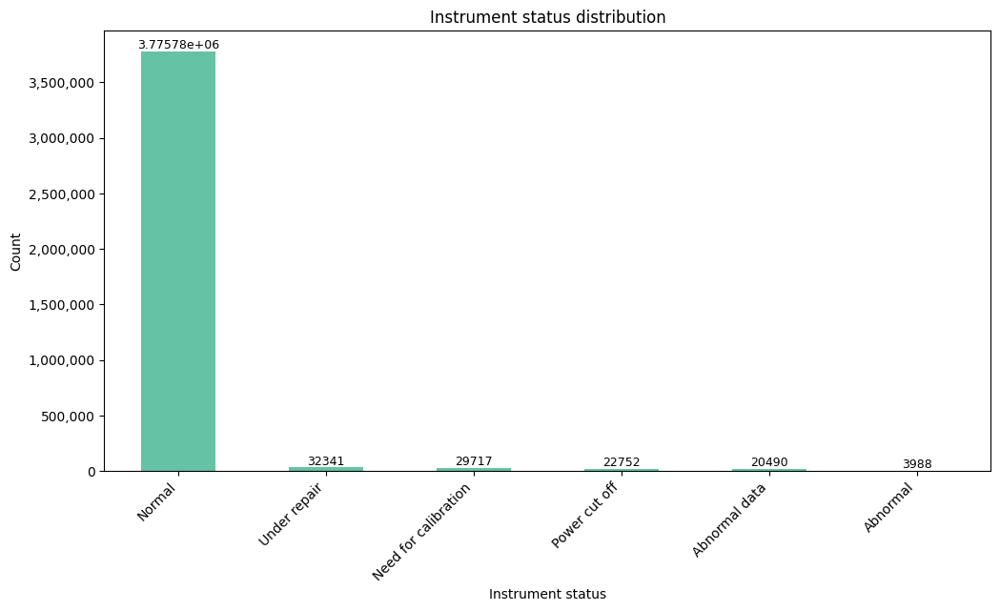

In [27]:
# count every status
status_counts = final_table["Instrument status"].value_counts(normalize=False)

# generate bar chart
plt.figure(figsize=(12,6))
status_counts.plot(kind='bar', colormap="Set2")
plt.title("Instrument status distribution")
plt.xlabel("Instrument status")
plt.ylabel("Count")
plt.xticks(rotation=45, ha="right")
plt.gca().yaxis.set_major_formatter(mtick.StrMethodFormatter('{x:,.0f}'))
# show numbers on top of each bar
for container in plt.gca().containers:
    plt.gca().bar_label(container, fontsize=9, rotation=0, label_type='edge')

# show chart
plt.show()

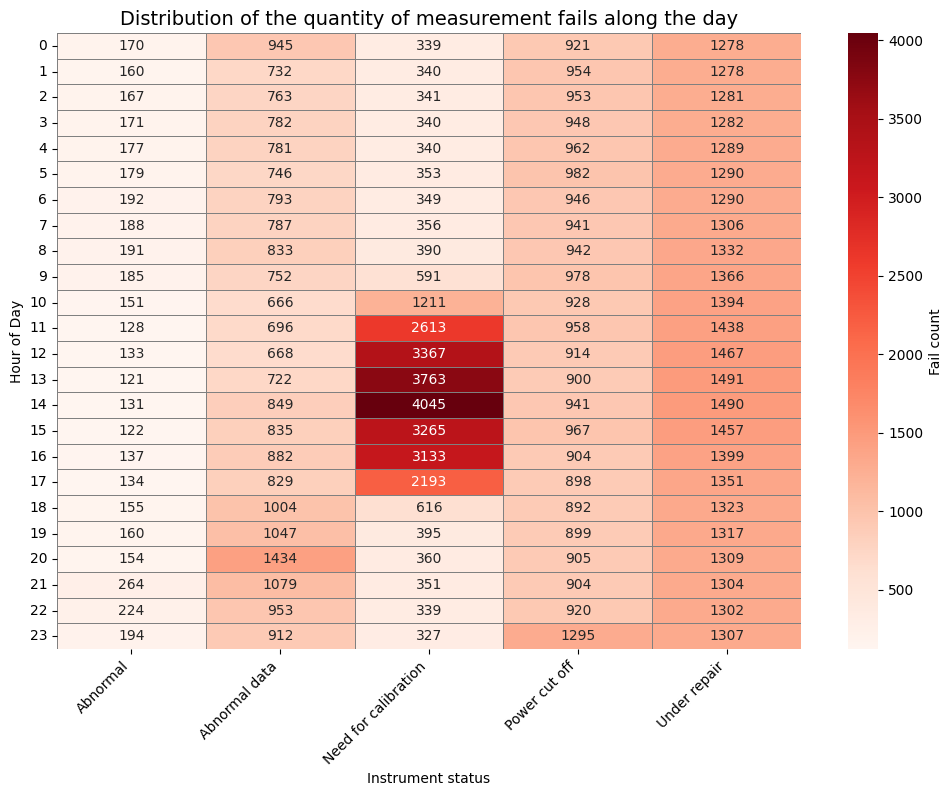

In [28]:
# convert Measurement date into datetime
final_table["Measurement date"] = pd.to_datetime(final_table["Measurement date"])

# filter failed data (!= Normal)
fail_final_table = final_table[final_table["Instrument status"] != "Normal"].copy()

# extract hour from Measurement date
fail_final_table["Hour"] = fail_final_table["Measurement date"].dt.hour

# count errors following status and hour
fail_counts = fail_final_table.groupby(["Hour", "Instrument status"]).size().reset_index(name="FailCount")

# pivoting matrix: Y = Hour, X = Instrument status
fail_matrix = fail_counts.pivot(index="Hour", columns="Instrument status", values="FailCount").fillna(0)

# generate heatmap
plt.figure(figsize=(12,8))
sns.heatmap(fail_matrix, cmap="Reds", cbar_kws={'label': 'Fail count'}, annot = True, fmt=".0f", linewidths=0.5, linecolor="gray")

plt.title("Distribution of the quantity of measurement fails along the day", fontsize=14)
plt.ylabel("Hour of Day")
plt.xlabel("Instrument status")
plt.yticks(rotation=0)
plt.xticks(rotation=45, ha="right")

plt.show()

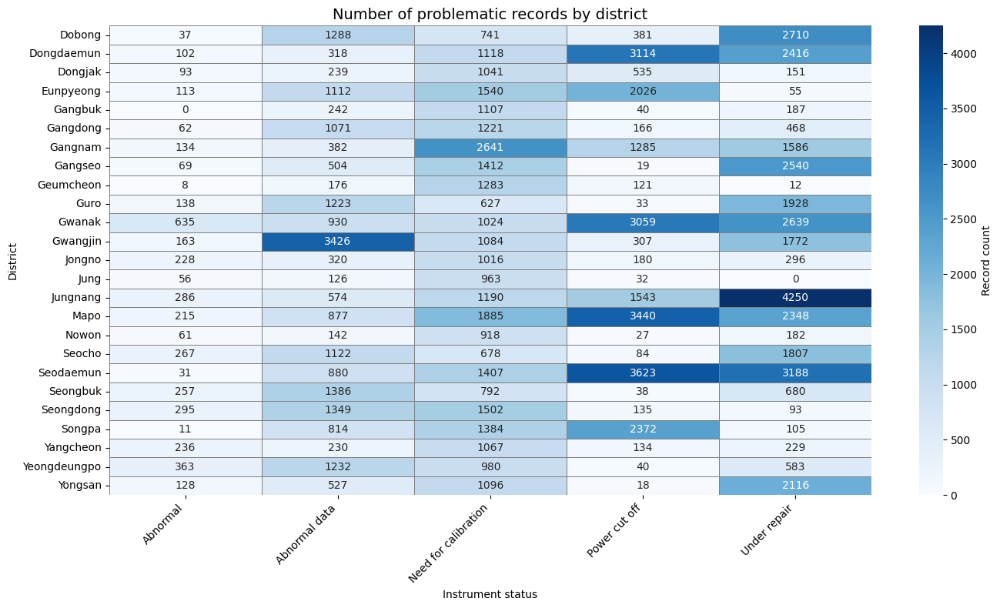

In [29]:
# filter out "Normal"
problem_counts = (
    final_table[final_table["Instrument status"] != "Normal"]
    .groupby(["Station name(district)", "Instrument status"])
    .size()
    .reset_index(name="Count")
)

# pivoting into matrix
problem_matrix = problem_counts.pivot(
    index="Station name(district)",
    columns="Instrument status",
    values="Count"
).fillna(0)

# generate heatmap
plt.figure(figsize=(14,8))
sns.heatmap(
    problem_matrix,
    cmap="Blues",
    cbar_kws={'label': 'Record count'},
    annot=True,
    fmt=".0f",
    linewidths=0.5,
    linecolor="gray"
)

plt.title("Number of problematic records by district", fontsize=14)
plt.ylabel("District")
plt.xlabel("Instrument status")
plt.xticks(rotation=45, ha="right")

plt.tight_layout()
plt.show()

## 1.7. Finalizing final_table

In [30]:
final_table = final_table[final_table["Instrument status"] == "Normal"].copy()

In [31]:
final_table

,Measurement date,Station code,Station name(district),Address,Latitude,Longitude,Item code,Item name,Unit of measurement,Average value,Category,Color,Instrument status
0,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.572,127.0050,1,SO2,ppm,0.004,Good,Blue,Normal
1,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.572,127.0050,3,NO2,ppm,0.059,Normal,Green,Normal
2,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.572,127.0050,5,CO,ppm,1.200,Good,Blue,Normal
3,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.572,127.0050,6,O3,ppm,0.002,Good,Blue,Normal
4,2017-01-01 00:00:00,101,Jongno,"19, Jong-ro 35ga-gil, Jongno District, Seoul, ...",37.572,127.0050,8,PM10,Mircrogram/m3,73.000,Normal,Green,Normal
...,...,...,...,...,...,...,...,...,...,...,...,...,...
3882741,2019-12-31 23:00:00,125,Gangdong,"59, Gucheonmyeon-ro 42-gil, Gangdong District,...",37.545,127.1368,3,NO2,ppm,0.037,Normal,Green,Normal
3882742,2019-12-31 23:00:00,125,Gangdong,"59, Gucheonmyeon-ro 42-gil, Gangdong District,...",37.545,127.1368,5,CO,ppm,0.500,Good,Blue,Normal
3882743,2019-12-31 23:00:00,125,Gangdong,"59, Gucheonmyeon-ro 42-gil, Gangdong District,...",37.545,127.1368,6,O3,ppm,0.005,Good,Blue,Normal
3882744,2019-12-31 23:00:00,125,Gangdong,"59, Gucheonmyeon-ro 42-gil, Gangdong District,...",37.545,127.1368,8,PM10,Mircrogram/m3,27.000,Good,Blue,Normal


In [32]:
final_table.info()

<class 'pandas.core.frame.DataFrame'>
Index: 3775778 entries, 0 to 3882745
Data columns (total 13 columns):
 #   Column                  Dtype         
---  ------                  -----         
 0   Measurement date        datetime64[ns]
 1   Station code            int64         
 2   Station name(district)  object        
 3   Address                 object        
 4   Latitude                float64       
 5   Longitude               float64       
 6   Item code               int64         
 7   Item name               object        
 8   Unit of measurement     object        
 9   Average value           float64       
 10  Category                object        
 11  Color                   object        
 12  Instrument status       object        
dtypes: datetime64[ns](1), float64(3), int64(2), object(7)
memory usage: 403.3+ MB


In [33]:
final_table.isna().sum()

,0
Measurement date,0
Station code,0
Station name(district),0
Address,0
Latitude,0
Longitude,0
Item code,0
Item name,0
Unit of measurement,0
Average value,0


In [34]:
final_table.duplicated().sum()

np.int64(0)

In [ ]:
#final_table.to_csv('final_table.csv', index=False)
#from google.colab import files
#files.download('final_table.csv')

# PART 2. POLLUTANT RELATIONSHIPS & CLUSTERING

In [35]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
import pandas as pd

from scipy.stats import pearsonr
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.decomposition import PCA

In [36]:
rd = final_table.copy()

## 2.1. Create wide-format DataFrame

In [37]:
df_values = rd.pivot_table(
    index=["Measurement date", "Station name(district)"],
    columns="Item name",
    values="Average value"
).reset_index()

df_categories = rd.pivot_table(
    index=["Measurement date", "Station name(district)"],
    columns="Item name",
    values="Category",
    aggfunc='first'
).reset_index()

# rename "Level" columns
df_categories = df_categories.rename(
    columns={col: f"{col} Level" for col in df_categories.columns
             if col not in ["Measurement date", "Station name(district)"]})

# merge value + category
df_wide = pd.merge(df_values, df_categories, on=["Measurement date",
                                                 "Station name(district)"])
df_wide

Item name,Measurement date,Station name(district),CO,NO2,O3,PM10,PM2.5,SO2,CO Level,NO2 Level,O3 Level,PM10 Level,PM2.5 Level,SO2 Level
0,2017-01-01 00:00:00,Dobong,0.9,0.051,0.002,81.0,40.0,0.006,Good,Normal,Good,Bad,Bad,Good
1,2017-01-01 00:00:00,Dongdaemun,1.1,0.052,0.002,76.0,50.0,0.006,Good,Normal,Good,Normal,Bad,Good
2,2017-01-01 00:00:00,Dongjak,1.2,0.062,0.002,63.0,49.0,0.006,Good,Bad,Good,Normal,Bad,Good
3,2017-01-01 00:00:00,Eunpyeong,0.6,0.045,0.003,73.0,46.0,0.005,Good,Normal,Good,Normal,Bad,Good
4,2017-01-01 00:00:00,Gangbuk,1.2,0.046,0.001,63.0,51.0,0.004,Good,Normal,Good,Normal,Bad,Good
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
637194,2019-12-31 23:00:00,Seongdong,0.5,0.039,0.005,19.0,14.0,0.003,Good,Normal,Good,Good,Good,Good
637195,2019-12-31 23:00:00,Songpa,0.5,0.035,0.004,20.0,13.0,0.003,Good,Normal,Good,Good,Good,Good
637196,2019-12-31 23:00:00,Yangcheon,0.5,0.042,0.002,25.0,16.0,0.004,Good,Normal,Good,Good,Normal,Good
637197,2019-12-31 23:00:00,Yeongdeungpo,0.8,0.039,0.002,21.0,14.0,0.003,Good,Normal,Good,Good,Good,Good


In [38]:
exx = rd.pivot_table(
    index=["Measurement date", "Station name(district)"],
    columns="Item name",
    values=["Average value", "Category"],
    aggfunc={"Average value": "mean", "Category": "first"}
).reset_index()
exx

Measurement date Station name(district) Average value         \
Item name                                                       CO    NO2   
0         2017-01-01 00:00:00                 Dobong           0.9  0.051   
1         2017-01-01 00:00:00             Dongdaemun           1.1  0.052   
2         2017-01-01 00:00:00                Dongjak           1.2  0.062   
3         2017-01-01 00:00:00              Eunpyeong           0.6  0.045   
4         2017-01-01 00:00:00                Gangbuk           1.2  0.046   
...                       ...                    ...           ...    ...   
637194    2019-12-31 23:00:00              Seongdong           0.5  0.039   
637195    2019-12-31 23:00:00                 Songpa           0.5  0.035   
637196    2019-12-31 23:00:00              Yangcheon           0.5  0.042   
637197    2019-12-31 23:00:00           Yeongdeungpo           0.8  0.039   
637198    2019-12-31 23:00:00                Yongsan           0.5  0.031   

                                    Category                                \
Item name     O3  PM10 PM2.5    SO2       CO     NO2    O3    PM10   PM2.5   
0          0.002  81.0  40.0  0.006     Good  Normal  Good     Bad     Bad   
1          0.002  76.0  50.0  0.006     Good  Normal  Good  Normal     Bad   
2          0.002  63.0  49.0  0.006     Good     Bad  Good  Normal     Bad   
3          0.003  73.0  46.0  0.005     Good  Normal  Good  Normal     Bad   
4          0.001  63.0  51.0  0.004     Good  Normal  Good  Normal     Bad   
...          ...   ...   ...    ...      ...     ...   ...     ...     ...   
637194     0.005  19.0  14.0  0.003     Good  Normal  Good    Good    Good   
637195     0.004  20.0  13.0  0.003     Good  Normal  Good    Good    Good   
637196     0.002  25.0  16.0  0.004     Good  Normal  Good    Good  Normal   
637197     0.002  21.0  14.0  0.003     Good  Normal  Good    Good    Good   
637198     0.003  12.0  13.0  0.003     Good  Normal  Good    Good    Good   

                 
Item name   SO2  
0          Good  
1          Good  
2          Good  
3          Good  
4          Good  
...         ...  
637194     Good  
637195     Good  
637196     Good  
637197     Good  
637198     Good  

[637199 rows x 14 columns]

In [39]:
print('Shape:', df_wide.shape)

Shape: (637199, 14)


## 2.2. Descriptive Statistics

In [40]:
pollutants = ["SO2", "NO2", "CO", "O3", "PM10", "PM2.5"]
stats = df_wide[pollutants].describe().T
stats

,count,mean,std,min,25%,50%,75%,max
Item name,,,,,,,,
SO2,630744.0,0.004321,0.001669,0.001,0.003,0.004,0.005,0.041
NO2,632564.0,0.028642,0.015967,0.000,0.016,0.025,0.038,0.123
CO,629784.0,0.516451,0.239620,0.000,0.400,0.500,0.600,3.200
O3,631120.0,0.024363,0.019112,0.000,0.009,0.021,0.035,0.215
PM10,624408.0,41.798675,29.299224,1.000,23.000,35.000,53.000,470.000
PM2.5,627158.0,24.081037,18.847195,1.000,12.000,19.000,31.000,205.000


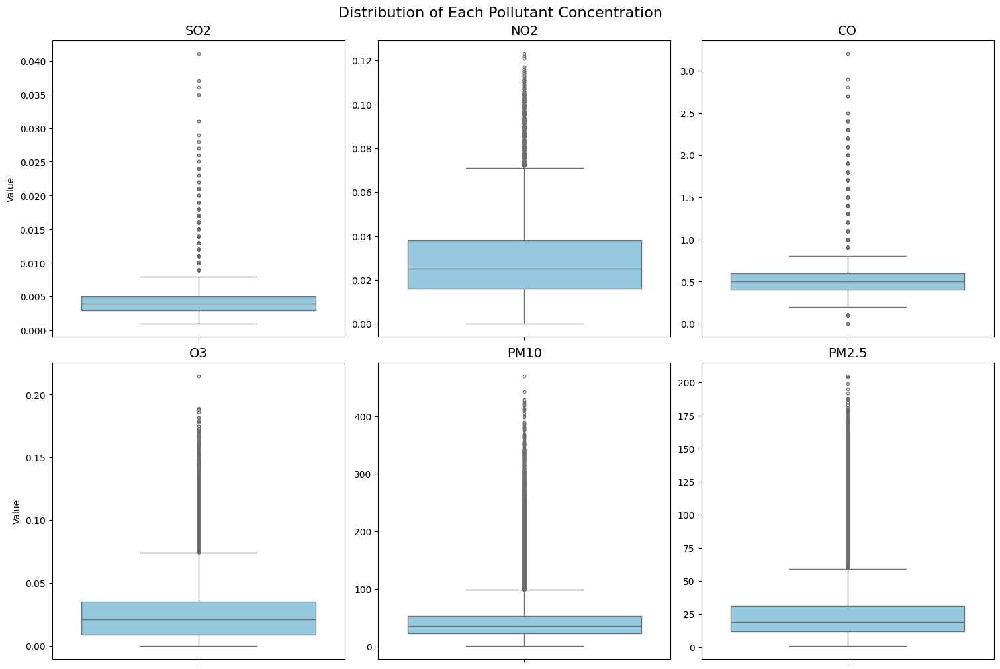

In [41]:
# boxplots
fig, ax = plt.subplots(2, 3, figsize=(15, 10), constrained_layout=True)
fig.suptitle('Distribution of Each Pollutant Concentration',
             fontsize=16,
             fontweight='normal')

axes = ax.flatten()

for n, pollutant in enumerate(pollutants):
    sns.boxplot(y=df_wide[pollutant], ax=axes[n],
                color="skyblue",
                fliersize=3)

    axes[n].set_title(pollutant, fontsize=14)
    axes[n].set_xlabel("")
    axes[n].set_ylabel("Value" if n % 3 == 0 else "")

# hide unused subplots
for k in range(len(pollutants), len(axes)):
    axes[k].set_visible(False)

plt.show()


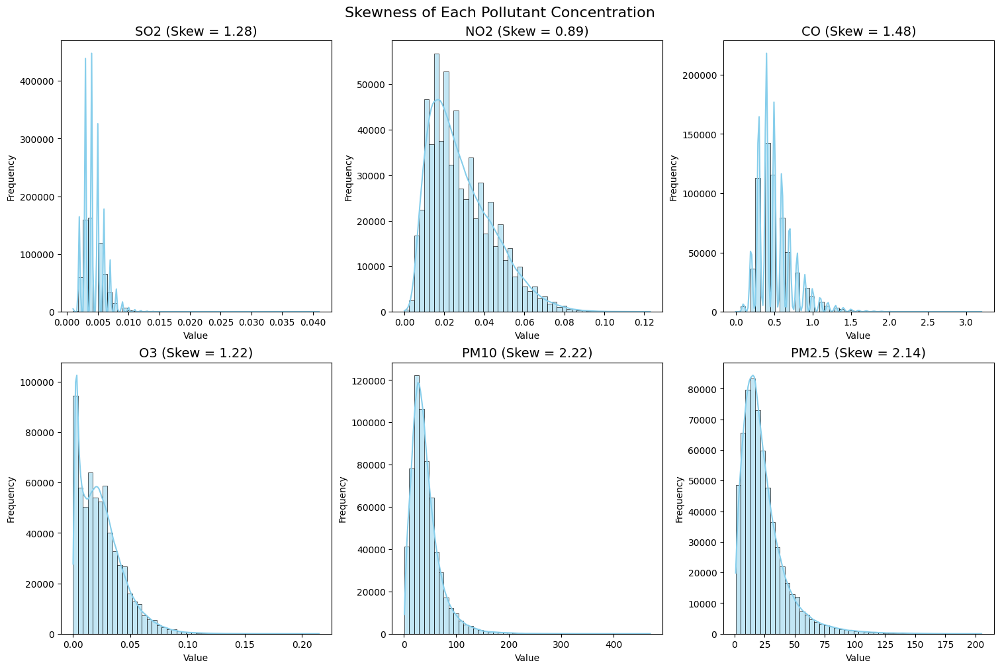

In [42]:
fig, ax = plt.subplots(2, 3, figsize=(15, 10), constrained_layout=True)
fig.suptitle('Skewness of Each Pollutant Concentration',
             fontsize=16, fontweight='normal')

axes = ax.flatten()

for n, pollutant in enumerate(pollutants):
    sns.histplot(df_wide[pollutant],
                 bins=50,
                 kde=True,
                 ax=axes[n],
                 color="skyblue")

    # calculate skewness
    skew_val = df_wide[pollutant].skew()

    axes[n].set_title(f"{pollutant} (Skew = {skew_val:.2f})", fontsize=14)
    axes[n].set_xlabel("Value")
    axes[n].set_ylabel("Frequency")

for k in range(len(pollutants), len(axes)):
    axes[k].set_visible(False)

plt.show()


## 2.3. Distribution by pollution level

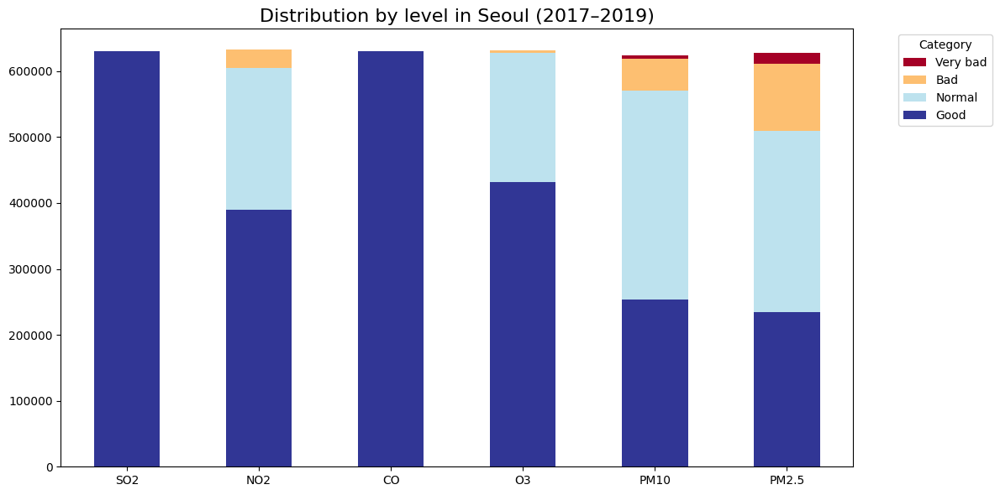

In [43]:
level_cols = ["SO2 Level","NO2 Level","CO Level",
              "O3 Level","PM10 Level","PM2.5 Level"]

level_counts = pd.concat(
    {col.replace(" Level",""): df_wide[col].value_counts()
    for col in level_cols},
    axis=1
).fillna(0.0)

level_counts = level_counts.loc[['Good','Normal','Bad','Very bad'], :]

ax = level_counts.T.plot(
    kind='bar',
    stacked=True,
    figsize=(12,6),
    rot=0,
    colormap='RdYlBu_r'
)

plt.title('Distribution by level in Seoul (2017–2019)', fontsize=16,
          fontweight='normal')

handles, labels = ax.get_legend_handles_labels()
ax.legend(handles[::-1], labels[::-1], title="Category",
          bbox_to_anchor=(1.05, 1), loc='upper left')

plt.tight_layout()
plt.show()

## 2.4. Correlation matrix + scatter plot

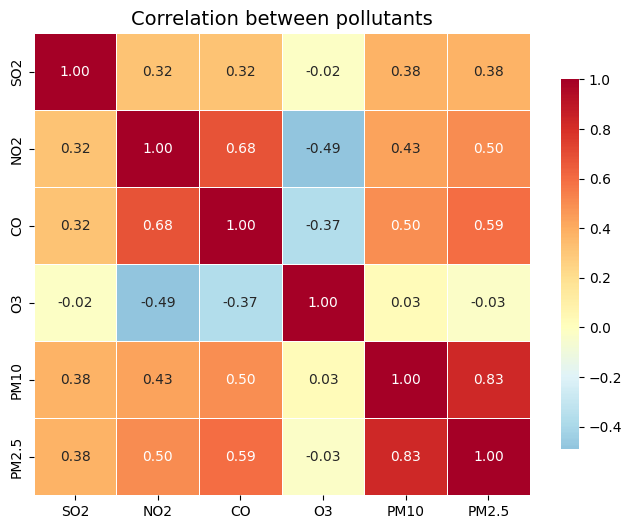

In [44]:
corr_matrix = df_wide[pollutants].corr()
#mask = np.triu(np.ones_like(corr_matrix, dtype=bool))
plt.figure(figsize=(8,6))
sns.heatmap(corr_matrix, annot=True, cmap="RdYlBu_r", center=0,
            fmt=".2f", linewidths=0.5, cbar_kws={"shrink": 0.8})
plt.title("Correlation between pollutants", fontsize=14, fontweight="normal")
plt.ylabel("")
plt.xlabel("")
plt.show()

In [45]:
px.scatter_matrix(df_wide, dimensions=["PM10", "PM2.5", "SO2", "CO", "NO2", "CO"])

In [46]:
corr_matrix

Item name,SO2,NO2,CO,O3,PM10,PM2.5
Item name,,,,,,
SO2,1.000000,0.318213,0.315920,-0.016477,0.377816,0.378089
NO2,0.318213,1.000000,0.684857,-0.490264,0.431670,0.499768
CO,0.315920,0.684857,1.000000,-0.365353,0.496954,0.594143
O3,-0.016477,-0.490264,-0.365353,1.000000,0.029222,-0.026699
PM10,0.377816,0.431670,0.496954,0.029222,1.000000,0.825560
PM2.5,0.378089,0.499768,0.594143,-0.026699,0.825560,1.000000


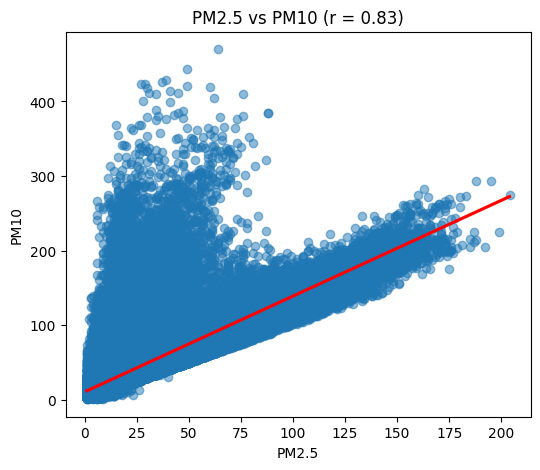

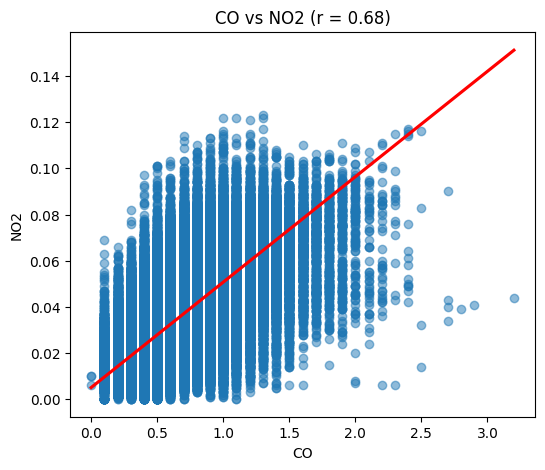

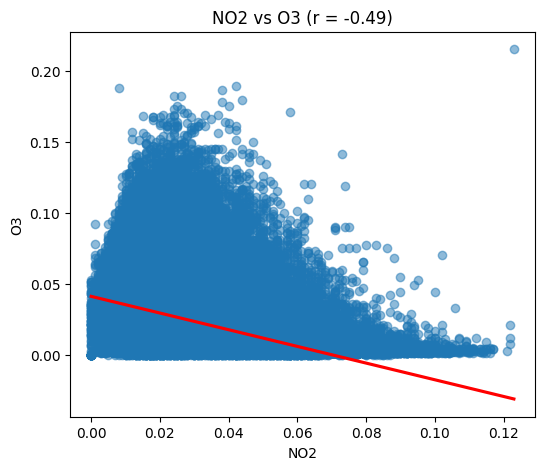

In [47]:
pairs = [("PM2.5", "PM10"), ("CO", "NO2"), ("NO2", "O3")]
for x, y in pairs:
    plt.figure(figsize=(6,5))
    sns.regplot(data=df_wide, x=x, y=y, scatter_kws={'alpha':0.5}, line_kws={'color':'red'})
    plt.title(f"{x} vs {y} (r = {corr_matrix.loc[x,y]:.2f})")
    plt.show()

## 2.5. Time-series correlation check (MinMax scaling)

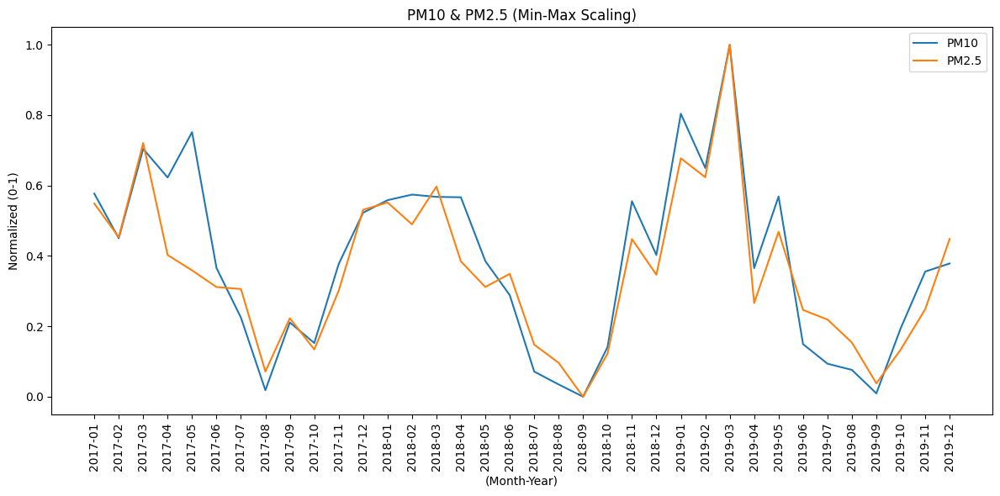

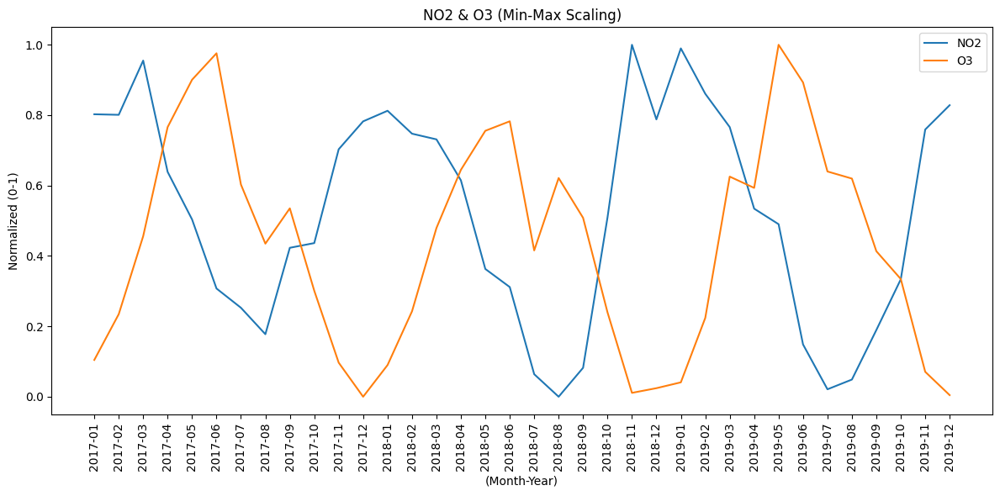

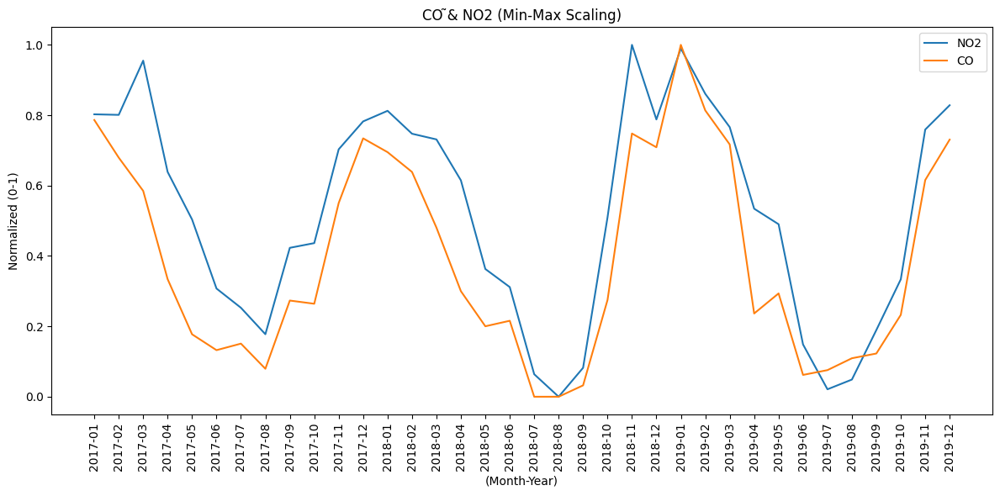

In [48]:
# monthly average
df_wide['year_month'] = pd.to_datetime(df_wide['Measurement date']).dt.to_period('M')
po = ["NO2", "O3"]
pl = ["NO2", "CO"]
pm = ["PM10", "PM2.5"]
monthly_mean = df_wide.groupby('year_month')[pollutants].mean()

# Min-Max Scaling
scaler = MinMaxScaler()
monthly_scaled = pd.DataFrame(scaler.fit_transform(monthly_mean),
                              index=monthly_mean.index,
                              columns=pollutants)

# Line chart drawing
plt.figure(figsize=(12,6))
for p in pm:
    plt.plot(monthly_scaled.index.astype(str), monthly_scaled[p], label=p)

plt.xticks(rotation=90)
plt.title("PM10 & PM2.5 (Min-Max Scaling)")
plt.xlabel("(Month-Year)")
plt.ylabel("Normalized (0-1)")
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(12,6))
for p in po:
    plt.plot(monthly_scaled.index.astype(str), monthly_scaled[p], label=p)

plt.xticks(rotation=90)
plt.title("NO2 & O3 (Min-Max Scaling)")
plt.xlabel("(Month-Year)")
plt.ylabel("Normalized (0-1)")
plt.legend()
plt.tight_layout()
plt.show()

plt.figure(figsize=(12,6))
for p in pl:
    plt.plot(monthly_scaled.index.astype(str), monthly_scaled[p], label=p)

plt.xticks(rotation=90)
plt.title("CO ̃& NO2 (Min-Max Scaling)")
plt.xlabel("(Month-Year)")
plt.ylabel("Normalized (0-1)")
plt.legend()
plt.tight_layout()
plt.show()


## 2.6. Pearson test with Cl

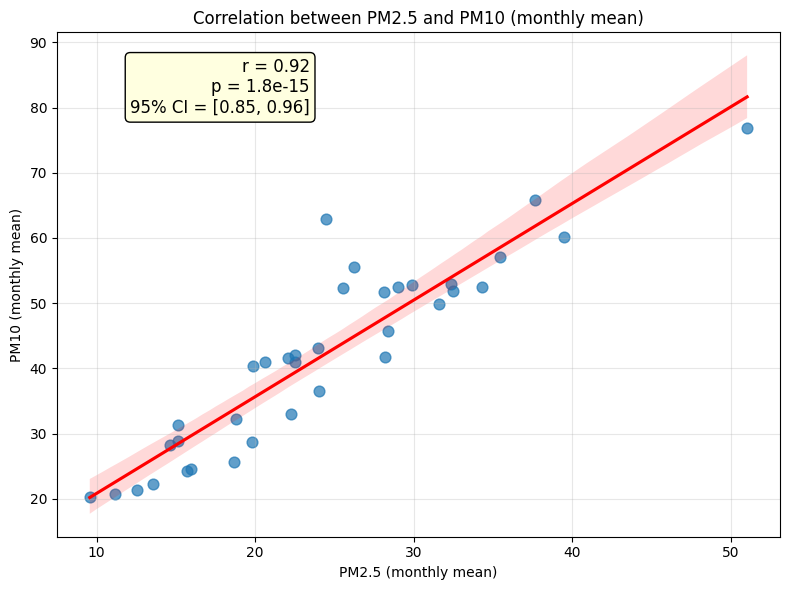

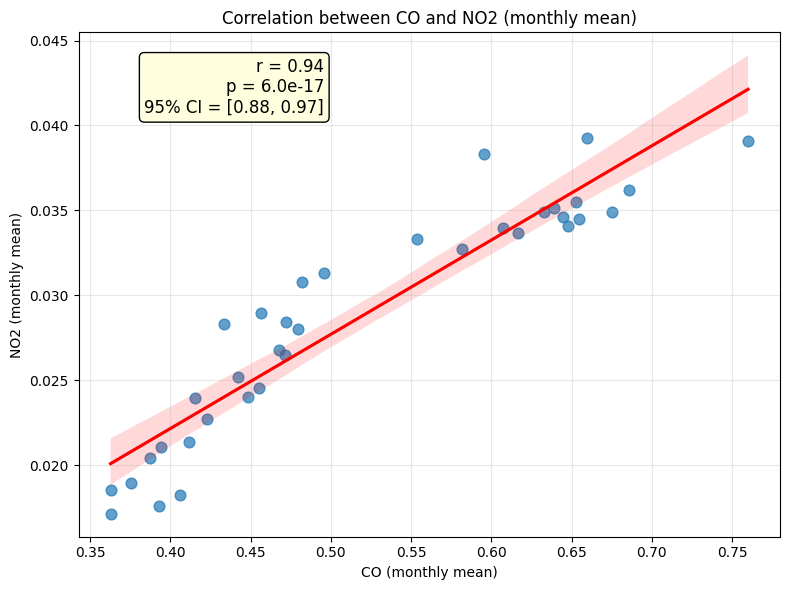

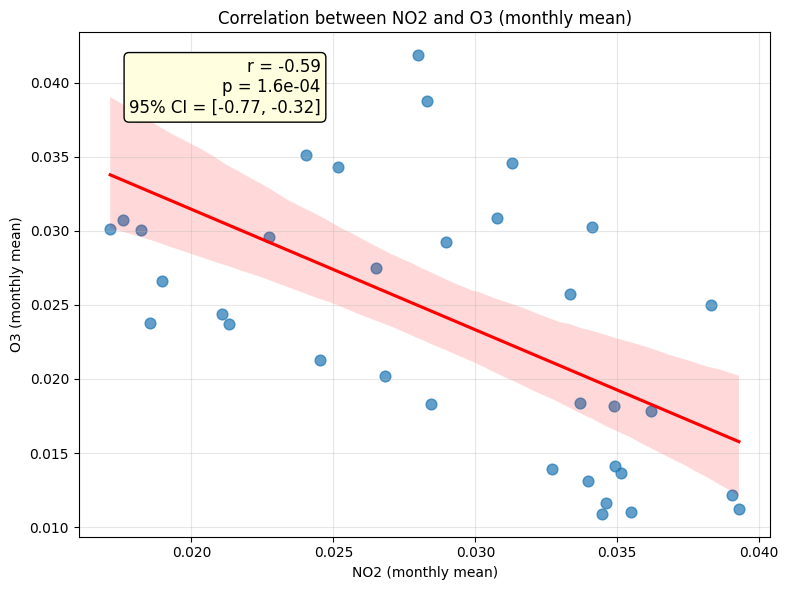

In [49]:
df_wide["Measurement date"] = pd.to_datetime(df_wide["Measurement date"])
df_monthly = df_wide.groupby(pd.Grouper(key="Measurement date", freq="ME"))[pollutants].mean().reset_index()

for x_col, y_col in pairs:
    r, p = pearsonr(df_monthly[x_col], df_monthly[y_col])

    n = df_monthly.shape[0]
    z = 0.5 * np.log((1 + r) / (1 - r))
    se = 1 / np.sqrt(n - 3)
    z_lo, z_hi = z - 1.96 * se, z + 1.96 * se
    r_lo = (np.exp(2*z_lo) - 1) / (np.exp(2*z_lo) + 1)
    r_hi = (np.exp(2*z_hi) - 1) / (np.exp(2*z_hi) + 1)

    plt.figure(figsize=(8,6))
    sns.regplot(
        x=x_col, y=y_col, data=df_monthly,
        scatter_kws={"s":60, "alpha":0.7},
        line_kws={"color":"red"}
    )
    plt.text(
        0.35, 0.95,
        f"r = {r:.2f}\np = {p:.1e}\n95% CI = [{r_lo:.2f}, {r_hi:.2f}]",
        transform=plt.gca().transAxes,
        fontsize=12,
        bbox=dict(boxstyle="round,pad=0.3", fc="lightyellow", ec="black", lw=1),
        ha="right", va="top"
    )

    plt.title(f"Correlation between {x_col} and {y_col} (monthly mean)")
    plt.xlabel(f"{x_col} (monthly mean)")
    plt.ylabel(f"{y_col} (monthly mean)")
    plt.grid(alpha=0.3)
    plt.tight_layout()
    plt.show()



## 2.7. Districts Clustering

In [50]:
district_mean = df_wide.groupby("Station name(district)")[["PM2.5","PM10","NO2","O3", "CO", "SO2"]].mean()
district_mean.sort_values("PM10", ascending=False)

Item name,PM2.5,PM10,NO2,O3,CO,SO2
Station name(district),,,,,,
Yeongdeungpo,26.672377,47.119630,0.029145,0.023391,0.572786,0.004467
Gangdong,24.384328,45.148452,0.030108,0.021882,0.506076,0.004061
Gwanak,27.140793,44.952635,0.031729,0.024572,0.461562,0.004697
Seocho,23.580883,44.459663,0.028619,0.025625,0.433196,0.004189
Seongbuk,23.092761,44.383064,0.031528,0.022206,0.640426,0.003626
Seongdong,24.677367,44.344436,0.028998,0.021646,0.479063,0.004350
Gangseo,23.778805,43.938042,0.030620,0.026373,0.488687,0.005089
Mapo,26.837519,43.929740,0.027629,0.024884,0.524545,0.003879
Guro,23.938327,43.384815,0.024559,0.025605,0.411519,0.005227


In [51]:
scalers = {
    "StandardScaler": StandardScaler(),
    "MinMaxScaler": MinMaxScaler(),
    "RobustScaler": RobustScaler()
}

results = {}

for scaler_name, scaler in scalers.items():
    print(f"\n=== {scaler_name} ===")
    X_scaled = scaler.fit_transform(district_mean[pollutants])

    for k in range(2, 6):
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X_scaled)
        labels = kmeans.labels_

        sil = silhouette_score(X_scaled, labels)
        print(f"k={k}, silhouette={sil:.3f}")

        results[(scaler_name, k)] = {
            "labels": labels,
            "silhouette": sil
        }



=== StandardScaler ===
k=2, silhouette=0.245
k=3, silhouette=0.171
k=4, silhouette=0.232
k=5, silhouette=0.226

=== MinMaxScaler ===
k=2, silhouette=0.240
k=3, silhouette=0.173
k=4, silhouette=0.226
k=5, silhouette=0.225

=== RobustScaler ===
k=2, silhouette=0.164
k=3, silhouette=0.257
k=4, silhouette=0.261
k=5, silhouette=0.237


In [52]:
# Scale with RobustScaler because highest silhouette = 2.61, k = 4
scaler = RobustScaler()
X_scaled = scaler.fit_transform(district_mean[pollutants])
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10).fit(X_scaled)
labels = kmeans.labels_

district_scaled = pd.DataFrame(X_scaled, index=district_mean.index, columns=pollutants)
district_scaled['Cluster'] = labels

counts = pd.Series(labels, index=district_mean.index).value_counts().sort_index()
print("Districts per cluster:\n", counts)

Districts per cluster:
 0     5
1    10
2     4
3     6
Name: count, dtype: int64


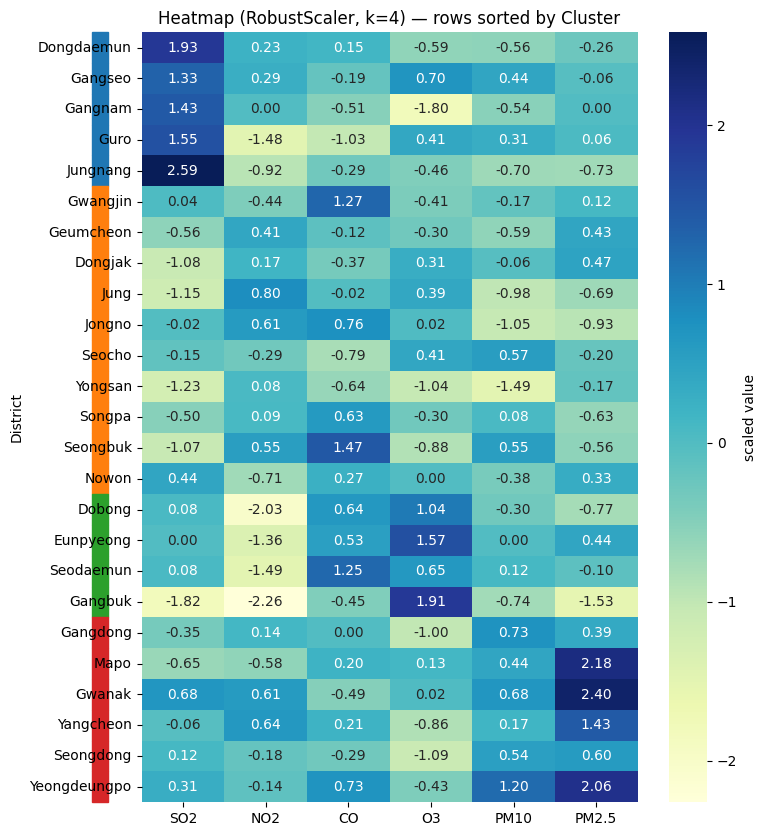

In [53]:
order = district_scaled.sort_values('Cluster').index
row_colors = pd.Series(labels, index=district_mean.index).map({
    0:'#1f77b4', 1:'#ff7f0e', 2:'#2ca02c', 3:'#d62728'
})

plt.figure(figsize=(8,10))
sns.heatmap(
    district_scaled.loc[order, pollutants],
    cmap="YlGnBu", annot=True, fmt=".2f",
    cbar_kws={'label':'scaled value'}
)
plt.ylabel("District")
plt.title("Heatmap (RobustScaler, k=4) — rows sorted by Cluster")

for i, (name, lab) in enumerate(row_colors.loc[order].items()):
    plt.gca().add_patch(
        plt.Rectangle((-0.6, i), 0.2, 1, color=lab,
                      transform=plt.gca().transData, clip_on=False)
    )

plt.show()

In [54]:
# centroids in normalized space (z-score)
centroids_scaled = kmeans.cluster_centers_
centroids_df_scaled = pd.DataFrame(centroids_scaled, columns=pollutants)
print("\nCentroids (z-score):\n", centroids_df_scaled.round(2))

# map centroid to its orginial unit
centroids_original = scaler.inverse_transform(centroids_scaled)
centroids_df_orig = pd.DataFrame(centroids_original, columns=pollutants)
print("\nCentroids (original units):\n", centroids_df_orig.round(2))

# average pollutant of clusters (original unit)
cluster_means = district_mean[pollutants].groupby(labels).mean()
print("\nCluster means (original units):\n", cluster_means.round(2))

# silhouette score (assessment of cluster quality)
sil_score = silhouette_score(X_scaled, labels)
print("\nSilhouette score:", round(sil_score, 3))


Centroids (z-score):
     SO2   NO2    CO    O3  PM10  PM2.5
0  1.77 -0.38 -0.37 -0.35 -0.21  -0.20
1 -0.53  0.13  0.25 -0.18 -0.35  -0.18
2 -0.41 -1.79  0.49  1.29 -0.23  -0.49
3  0.01  0.08  0.06 -0.54  0.63   1.51

Centroids (original units):
     SO2   NO2    CO    O3   PM10  PM2.5
0  0.01  0.03  0.47  0.02  41.24  23.59
1  0.00  0.03  0.53  0.02  40.64  23.61
2  0.00  0.02  0.55  0.03  41.14  23.19
3  0.00  0.03  0.51  0.02  44.71  25.92

Cluster means (original units):
 Item name   SO2   NO2    CO    O3   PM10  PM2.5
0          0.01  0.03  0.47  0.02  41.24  23.59
1          0.00  0.03  0.53  0.02  40.64  23.61
2          0.00  0.02  0.55  0.03  41.14  23.19
3          0.00  0.03  0.51  0.02  44.71  25.92

Silhouette score: 0.261


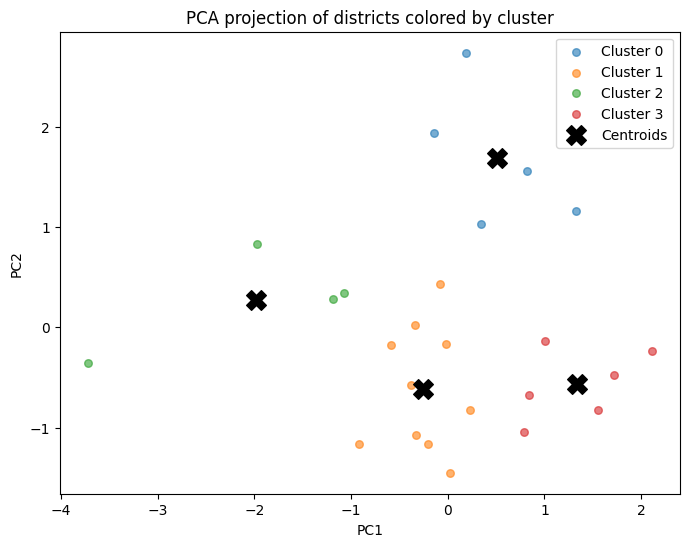

In [55]:
# PCA 2D for visualization
pca = PCA(n_components=2)
proj = pca.fit_transform(X_scaled)
centroids_2d = pca.transform(centroids_scaled)

plt.figure(figsize=(8,6))
palette = sns.color_palette("tab10", n_colors=len(np.unique(labels)))
for lbl in np.unique(labels):
    idx = labels == lbl
    plt.scatter(proj[idx,0], proj[idx,1], s=30, alpha=0.6, label=f"Cluster {lbl}", color=palette[lbl])
plt.scatter(centroids_2d[:,0], centroids_2d[:,1], marker='X', s=200, c='black', label='Centroids')
plt.legend()
plt.title("PCA projection of districts colored by cluster")
plt.xlabel("PC1"); plt.ylabel("PC2")
plt.show()

# PART 3. SPATIAL ANALYSIS (MAPPING)

In [56]:
import folium
import requests
import pandas as pd

from scipy.stats import zscore
from folium import Choropleth, Marker
from folium.plugins import HeatMapWithTime
from IPython.display import display, Markdown
from scipy.stats import zscore

## 3.1. Station distribution map

In [57]:
# Load GeoJSON (Seoul district borders)
url = "https://raw.githubusercontent.com/southkorea/seoul-maps/master/juso/2015/json/seoul_municipalities_geo_simple.json"
district_borders = requests.get(url).json()

# Base map centered on Seoul
stations_map = folium.Map(location=[37.562600, 127.024612],
                          tiles='cartodbpositron',
                          zoom_start=11)

# Add markers for each monitoring station
for idx, row in measurement_station_info.iterrows():
    folium.Marker(
        location=[row['Latitude'], row['Longitude']],
        popup=row['Station name(district)'],
        icon=folium.Icon(color='blue', icon='info-sign')
    ).add_to(stations_map)

# Add district boundaries
folium.GeoJson(
    district_borders,
    name='geojson'
).add_to(stations_map)

stations_map


## 3.2. Average pollutant levels per district

In [58]:
district_pollutants = final_table[['Station name(district)', 'Item name', 'Average value']]

district_pollutants = district_pollutants.groupby(['Station name(district)', 'Item name'])['Average value'].mean().reset_index()

district_pollutants

,Station name(district),Item name,Average value
0,Dobong,CO,0.564379
1,Dobong,NO2,0.022643
2,Dobong,O3,0.027292
3,Dobong,PM10,40.848864
4,Dobong,PM2.5,22.811576
...,...,...,...
145,Yongsan,NO2,0.029922
146,Yongsan,O3,0.021774
147,Yongsan,PM10,35.903055
148,Yongsan,PM2.5,23.621791


In [59]:
district_pollutants = district_pollutants.groupby(['Station name(district)', 'Item name'])['Average value'].mean().reset_index()

district_pollutants

,Station name(district),Item name,Average value
0,Dobong,CO,0.564379
1,Dobong,NO2,0.022643
2,Dobong,O3,0.027292
3,Dobong,PM10,40.848864
4,Dobong,PM2.5,22.811576
...,...,...,...
145,Yongsan,NO2,0.029922
146,Yongsan,O3,0.021774
147,Yongsan,PM10,35.903055
148,Yongsan,PM2.5,23.621791


In [60]:
# Convert to wide format for easier analysis
district_pollutants_mean = district_pollutants.pivot(index='Station name(district)',
                                                     columns='Item name',
                                                     values='Average value')

district_pollutants_mean = district_pollutants_mean.reset_index()

district_pollutants_mean

Item name,Station name(district),CO,NO2,O3,PM10,PM2.5,SO2
0,Dobong,0.564379,0.022643,0.027292,40.848864,22.811576,0.004326
1,Dongdaemun,0.520057,0.030409,0.022960,39.774768,23.506846,0.005458
2,Dongjak,0.472312,0.030220,0.025339,41.863274,24.497311,0.003620
3,Eunpyeong,0.554424,0.024964,0.028690,42.103835,24.458824,0.004278
4,Gangbuk,0.465164,0.021854,0.029587,39.002577,21.768244,0.003167
5,Gangdong,0.506076,0.030108,0.021882,45.148452,24.384328,0.004061
6,Gangnam,0.459371,0.029630,0.019781,39.868243,23.857633,0.005154
7,Gangseo,0.488687,0.030620,0.026373,43.938042,23.778805,0.005089
8,Geumcheon,0.494982,0.031047,0.023745,39.659207,24.441222,0.003933
9,Guro,0.411519,0.024559,0.025605,43.384815,23.938327,0.005227


In [61]:
# Apply zscore to numeric columns, skipping the first 2 columns (Item name, Station name)
district_pollutants_zscore = district_pollutants_mean.copy()
numeric_cols = district_pollutants_mean.columns[2:]

district_pollutants_zscore[numeric_cols] = district_pollutants_zscore[numeric_cols].apply(zscore)

district_pollutants_zscore

Item name,Station name(district),CO,NO2,O3,PM10,PM2.5,SO2
0,Dobong,0.564379,-2.060412,1.315115,-0.362789,-0.977026,0.000798
1,Dongdaemun,0.520057,0.611409,-0.629498,-0.764778,-0.446068,1.787432
2,Dongjak,0.472312,0.546431,0.438727,0.016863,0.310322,-1.113935
3,Eunpyeong,0.554424,-1.261889,1.943100,0.106896,0.280930,-0.075375
4,Gangbuk,0.465164,-2.331733,2.345428,-1.053777,-1.773789,-1.829240
5,Gangdong,0.506076,0.507917,-1.113551,1.246370,0.224040,-0.417040
6,Gangnam,0.459371,0.343629,-2.056432,-0.729794,-0.178182,1.307856
7,Gangseo,0.488687,0.684032,0.902894,0.793363,-0.238381,1.204757
8,Geumcheon,0.494982,0.831001,-0.277071,-0.808028,0.267488,-0.619161
9,Guro,0.411519,-1.401341,0.558092,0.586313,-0.116558,1.423119


## 3.3. Prepare pollutant data (mean / z-score)

In [62]:
def prepare_pollutant_data(final_table, use_zscore=False):
# Create DataFrame of average concentration per district and pollutant.
# If use_zscore=True, standardize pollutants by Z-score.
    df = (
        final_table
        .groupby(['Station name(district)', 'Item name'])['Average value']
        .mean()
        .reset_index()
    )
    # Key for joining with GeoJSON
    df['SIG_ENG_NM'] = df['Station name(district)'].str.strip() + '-gu'

    if use_zscore:
        # Pivot and apply z-score standardization
        wide = df.pivot(index='Station name(district)',
                        columns='Item name',
                        values='Average value')
        wide = wide.apply(zscore).reset_index()
        df = wide.melt(id_vars='Station name(district)',
                       var_name='Item name',
                       value_name='Average value')
        df['SIG_ENG_NM'] = df['Station name(district)'].str.strip() + '-gu'
    return df

## 3.4. Plot choropleth maps

In [63]:
def plot_maps(df, district_borders, pollutants, legend_suffix="", cmap="YlOrRd"):

# Plot one choropleth map per pollutant. Input DataFrame must contain: ['SIG_ENG_NM','Item name','Average value'].
    for pol in pollutants:
        df_p = df[df['Item name']==pol]

        m = folium.Map(location=[37.5626, 127.0246],
                       tiles='cartodbpositron', zoom_start=11)

        Choropleth(
            geo_data=district_borders,
            data=df_p[['SIG_ENG_NM', 'Average value']],
            columns=['SIG_ENG_NM', 'Average value'],
            key_on='feature.properties.SIG_ENG_NM',
            fill_color=cmap,
            fill_opacity=0.8,
            line_opacity=0.3,
            nan_fill_color='lightgray',
            legend_name=f'{pol} {legend_suffix}'
        ).add_to(m)

        # Add monitoring station markers
        for _, r in measurement_station_info.iterrows():
            Marker([r['Latitude'], r['Longitude']],
                   popup=r['Station name(district)']).add_to(m)

        display(Markdown(f'<center><h3>{pol} {legend_suffix}</h3></center>'))
        display(m)

## 3.5. Mean concentration maps

In [64]:
df_mean = prepare_pollutant_data(final_table, use_zscore=False)
plot_maps(df_mean, district_borders, df_mean['Item name'].unique(), legend_suffix="(Mean concentration)")

<center><h3>CO (Mean concentration)</h3></center>

<center><h3>NO2 (Mean concentration)</h3></center>

<center><h3>O3 (Mean concentration)</h3></center>

<center><h3>PM10 (Mean concentration)</h3></center>

<center><h3>PM2.5 (Mean concentration)</h3></center>

<center><h3>SO2 (Mean concentration)</h3></center>

## 3.7. Z-score standardized maps

In [65]:
df_z = prepare_pollutant_data(final_table, use_zscore=True)
plot_maps(df_z, district_borders, df_z['Item name'].unique(), legend_suffix="(Z-score)", cmap="YlGnBu")

<center><h3>CO (Z-score)</h3></center>

<center><h3>NO2 (Z-score)</h3></center>

<center><h3>O3 (Z-score)</h3></center>

<center><h3>PM10 (Z-score)</h3></center>

<center><h3>PM2.5 (Z-score)</h3></center>

<center><h3>SO2 (Z-score)</h3></center>

# PART 4. TEMPORAL ANALYSIS

In [66]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [67]:
# Normalize datetime
final_table.loc[:, "Measurement date"] = pd.to_datetime(final_table["Measurement date"])

# Group pollutants by type
pm_list = ["PM10", "PM2.5"]
gas_list = ["CO", "NO2", "O3", "SO2"]

# Helper function
def get_ylabel(pollutants):
    if set(pollutants).issubset(set(pm_list)):
        return "Average concentration (µg/m³)"
    else:
        return "Average concentration (ppm)"

## 4.1. Monthly trends

In [68]:
def plot_monthly_trend(df, pollutants, title_suffix="", log_scale=False):
    monthly = (df.groupby([pd.Grouper(key="Measurement date", freq="MS"), "Item name"])["Average value"]
                 .mean().reset_index())

    plt.figure(figsize=(12,5))
    ax = sns.lineplot(data=monthly[monthly["Item name"].isin(pollutants)],
                 x="Measurement date", y="Average value", hue="Item name", marker="o")
    if log_scale:
        ax.set_yscale("log")
    plt.title(f"Monthly Average Trend {title_suffix}")
    plt.xlabel("Month")
    plt.ylabel(get_ylabel(pollutants))
    plt.grid(True, alpha=0.3, which="both")
    plt.legend(bbox_to_anchor=(1.05, 0.5), title="Item name", loc="center left")
    plt.tight_layout()
    plt.show()

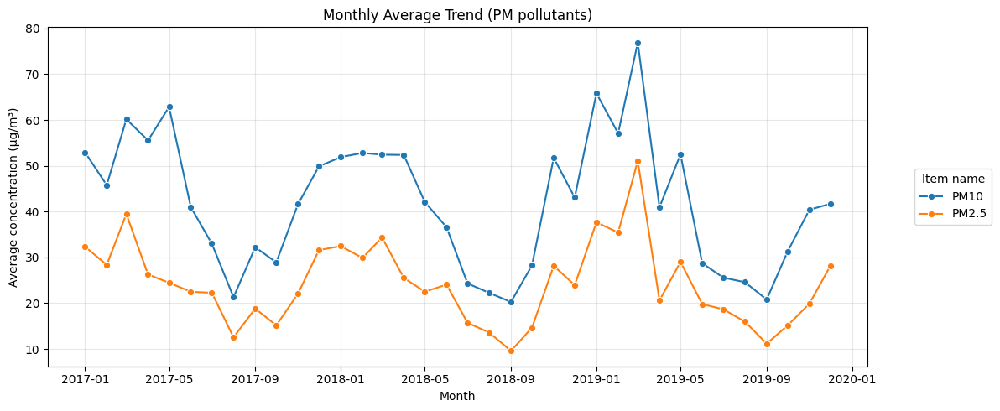

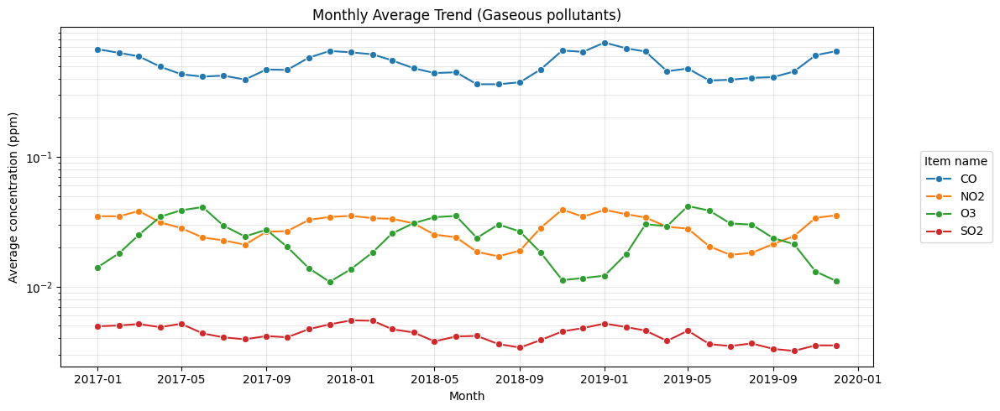

In [69]:
plot_monthly_trend(final_table, pm_list, "(PM pollutants)")
plot_monthly_trend(final_table, gas_list, "(Gaseous pollutants)", log_scale=True)

## 4.2. Hourly Patterns

In [70]:
def plot_hourly_pattern(df, pollutants, title_suffix="", log_scale=False):
    df = df.copy()
    df["hour"] = df["Measurement date"].dt.hour
    hourly = df.groupby(["hour", "Item name"])["Average value"].mean().reset_index()

    plt.figure(figsize=(12,5))
    ax = sns.lineplot(data=hourly[hourly["Item name"].isin(pollutants)],
                 x="hour", y="Average value", hue="Item name", marker="o")
    if log_scale:
        ax.set_yscale("log")
    plt.title(f"Hourly Average Pattern {title_suffix}")
    plt.xlabel("Hour of day")
    plt.ylabel(get_ylabel(pollutants))
    plt.grid(True, alpha=0.3, which="both")
    plt.legend(bbox_to_anchor=(1.05, 0.5), title="Item name", loc="center left")
    plt.tight_layout()
    plt.show()

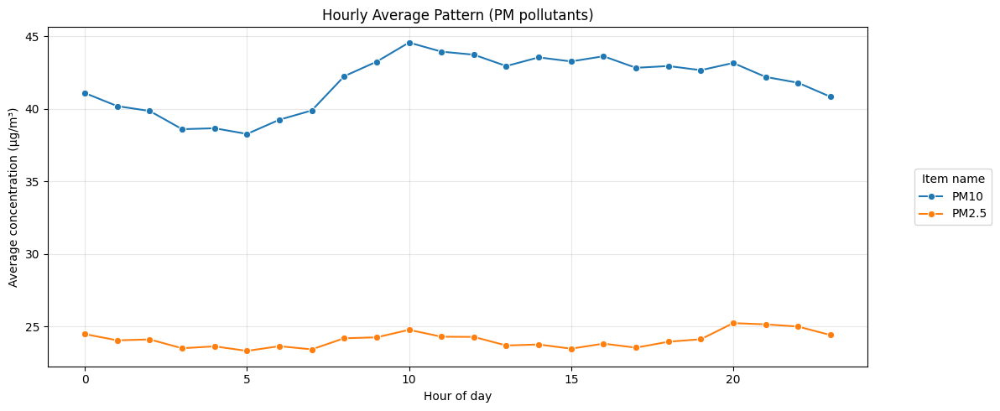

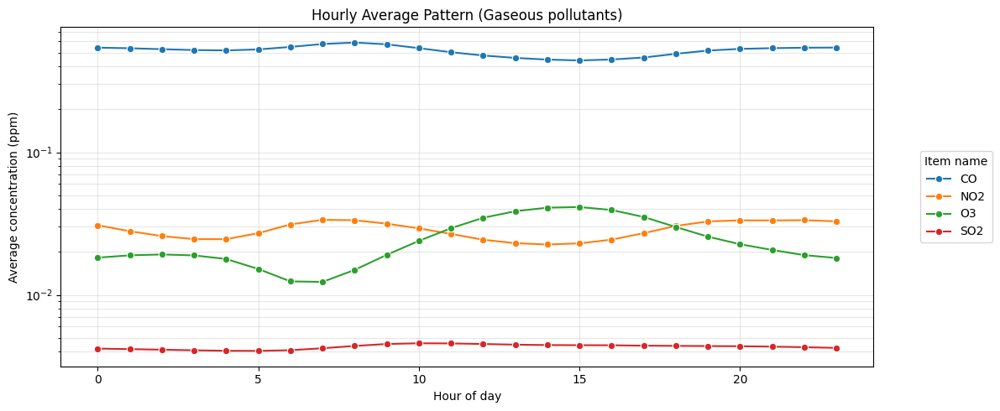

In [71]:
plot_hourly_pattern(final_table, pm_list, "(PM pollutants)")
plot_hourly_pattern(final_table, gas_list, "(Gaseous pollutants)", log_scale=True)

## 4.3. Day-of-Week Patterns

In [72]:
def plot_dow_pattern(df, pollutants, title_suffix="", log_scale=False):
    df = df.copy()
    df["dayofweek"] = df["Measurement date"].dt.dayofweek
    dow = df.groupby(["dayofweek", "Item name"])["Average value"].mean().reset_index()

    plt.figure(figsize=(12,5))
    ax = sns.lineplot(data=dow[dow["Item name"].isin(pollutants)],
                 x="dayofweek", y="Average value", hue="Item name", marker="o")
    if log_scale:
        ax.set_yscale("log")
    plt.title(f"Day-of-Week Pattern {title_suffix}")
    plt.xlabel("Day of Week")
    plt.ylabel(get_ylabel(pollutants))
    plt.xticks(range(7), ["Mon","Tue","Wed","Thu","Fri","Sat","Sun"])
    plt.grid(True, alpha=0.3, which="both")
    plt.legend(bbox_to_anchor=(1.05, 0.5), title="Item name", loc="center left")
    plt.tight_layout()
    plt.show()

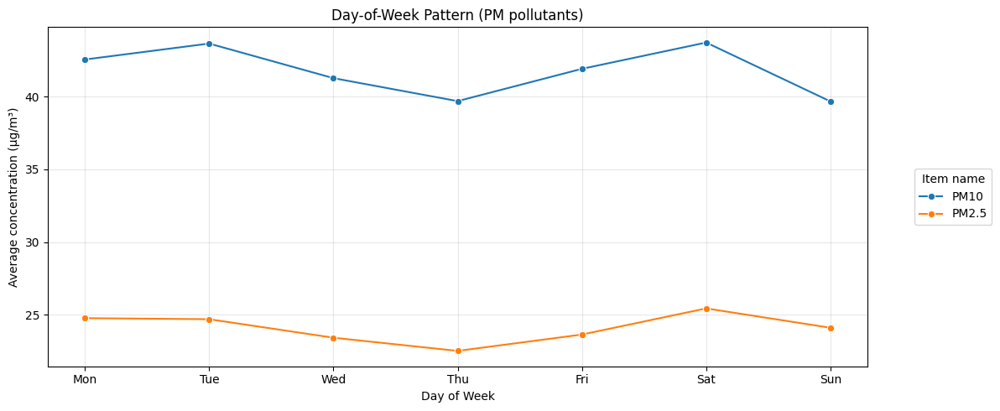

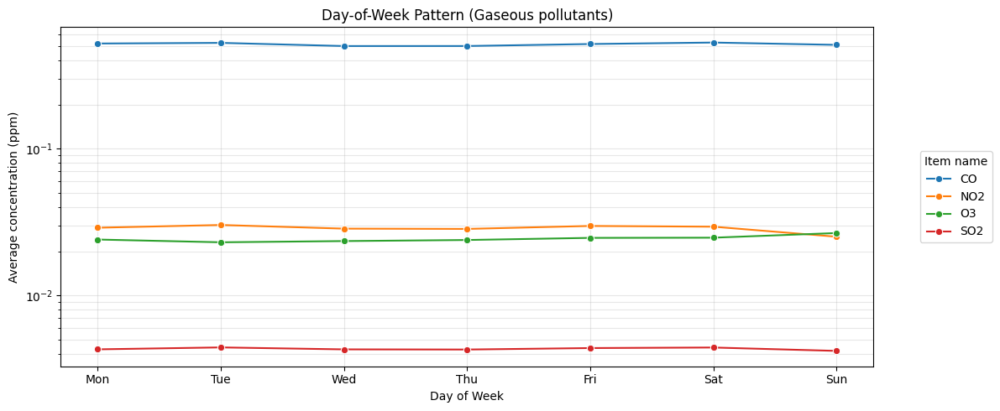

In [73]:
plot_dow_pattern(final_table, pm_list, "(PM pollutants)")
plot_dow_pattern(final_table, gas_list, "(Gaseous pollutants)", log_scale=True)

## 4.4. Weekly Trends

In [74]:
def plot_weekly_trend(df, pollutants, title_suffix="", log_scale=False):
    df = df.copy()
    df["week"] = df["Measurement date"].dt.isocalendar().week
    weekly = df.groupby(["week", "Item name"])["Average value"].mean().reset_index()

    plt.figure(figsize=(12,5))
    ax = sns.lineplot(data=weekly[weekly["Item name"].isin(pollutants)],
                 x="week", y="Average value", hue="Item name", marker="o")
    if log_scale:
        ax.set_yscale("log")
    plt.title(f"Weekly Average Trend {title_suffix}")
    plt.xlabel("Week of Year (1–52)")
    plt.ylabel(get_ylabel(pollutants))
    plt.grid(True, alpha=0.3, which="both")
    plt.legend(bbox_to_anchor=(1.05, 0.5), title="Item name", loc="center left")
    plt.tight_layout()
    plt.show()

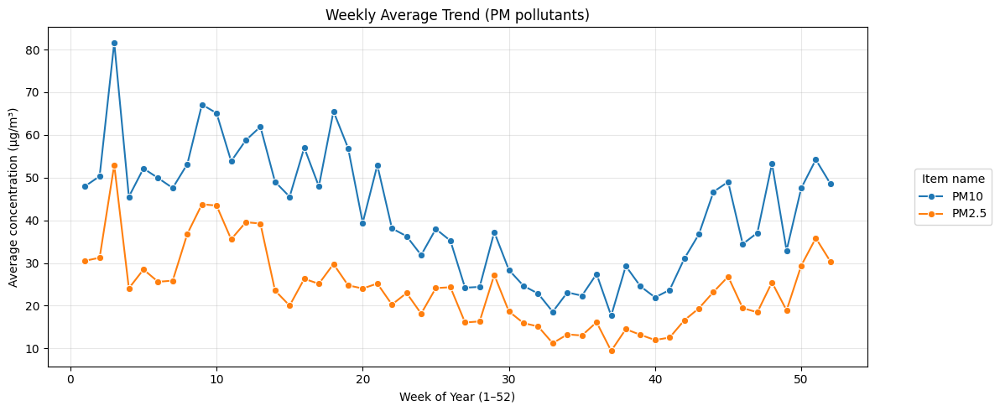

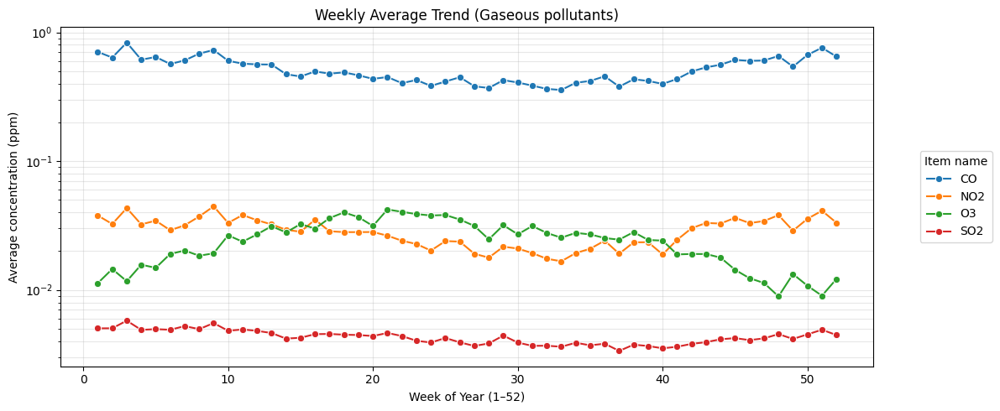

In [75]:
plot_weekly_trend(final_table, pm_list, "(PM pollutants)")
plot_weekly_trend(final_table, gas_list, "(Gaseous pollutants)", log_scale=True)

## 4.5. Seasonal Patterns

In [76]:
def get_season(month):
    if month in [3,4,5]:
        return "Spring"
    elif month in [6,7,8]:
        return "Summer"
    elif month in [9,10,11]:
        return "Autumn"
    else:
        return "Winter"

def plot_seasonal_pattern(df, pollutants, title_suffix="", log_scale=False):
    df = df.copy()
    df["season"] = df["Measurement date"].dt.month.map(get_season)
    seasonal = df.groupby(["season", "Item name"])["Average value"].mean().reset_index()
    season_order = ["Spring","Summer","Autumn","Winter"]

    plt.figure(figsize=(10,5))
    ax = sns.lineplot(data=seasonal[seasonal["Item name"].isin(pollutants)],
                 x="season", y="Average value", hue="Item name", marker="o")
    if log_scale:
        ax.set_yscale("log")
    plt.title(f"Seasonal Average Pattern {title_suffix}")
    plt.xlabel("Season")
    plt.ylabel(get_ylabel(pollutants))
    plt.xticks(season_order)
    plt.grid(True, alpha=0.3, which="both")
    plt.legend(bbox_to_anchor=(1.05, 0.5), title="Item name", loc="center left")
    plt.tight_layout()
    plt.show()

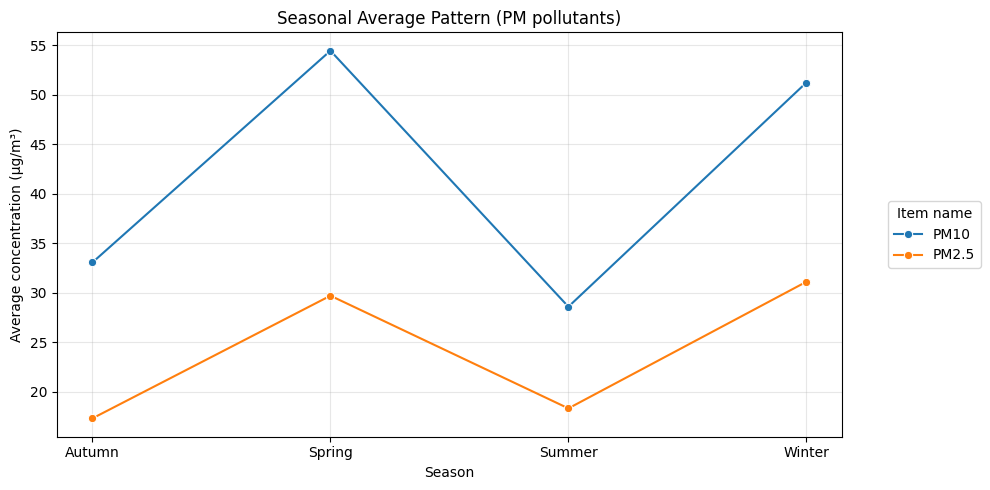

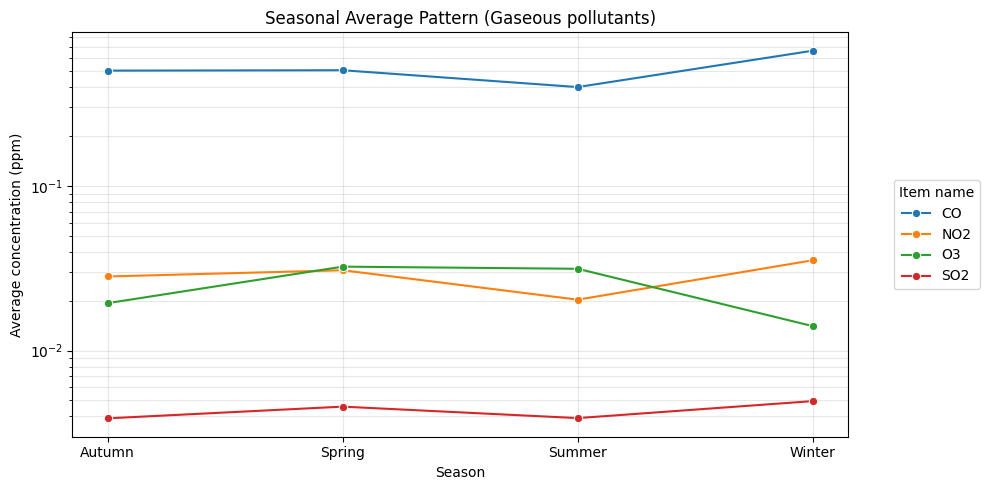

In [77]:
plot_seasonal_pattern(final_table, pm_list, "(PM pollutants)")
plot_seasonal_pattern(final_table, gas_list, "(Gaseous pollutants)", log_scale=True)

# PART 5. AIR POLLUTION AND LUNG CANCER

In [78]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

import statsmodels.api as sm
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

from scipy.stats import pearsonr

from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression, RidgeCV, LassoCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA

## 5.1. Prepare the data

In [79]:
# Copy & ensure datetime
air = df_wide.copy()
air["Measurement date"] = pd.to_datetime(air["Measurement date"], errors="coerce")

# Annual average by district
pollutants = ["CO","NO2","O3","SO2","PM10","PM2.5"]

air_annual = (
    air.groupby([air["Station name(district)"], air["Measurement date"].dt.year])[pollutants]
       .mean()
       .reset_index()
       .rename(columns={"Station name(district)":"district", "Measurement date":"year"})
)

air_annual

Item name,district,year,CO,NO2,O3,SO2,PM10,PM2.5
0,Dobong,2017,0.522510,0.025971,0.027104,0.004547,43.599368,23.565274
1,Dobong,2018,0.615067,0.022520,0.026234,0.004629,40.799198,22.772156
2,Dobong,2019,0.560990,0.019313,0.028520,0.003800,38.025431,22.076876
3,Dongdaemun,2017,0.487923,0.029507,0.021544,0.004932,43.897026,22.458704
4,Dongdaemun,2018,0.548455,0.032926,0.021058,0.006594,36.034884,23.369397
...,...,...,...,...,...,...,...,...
70,Yeongdeungpo,2018,0.571228,0.026903,0.022021,0.005109,47.462289,27.810503
71,Yeongdeungpo,2019,0.477713,0.031057,0.022438,0.003331,44.245525,28.896461
72,Yongsan,2017,0.400656,0.028549,0.020132,0.003834,39.276830,24.526413
73,Yongsan,2018,0.448193,0.029546,0.022320,0.003497,34.270234,22.597017


## 5.2. Load Lung Cancer Data

In [80]:
cancer_case = pd.read_csv('/content/drive/MyDrive/AirPollutionSeoul/Original Data/Cancer_cases_in_Seoul_new.csv')

cancer_case

,지치구별(1),지치구별(2),암유형별(1),2017,2017.1,2017.2,2017.3,2017.4,2018,2018.1,...,2019,2019.1,2019.2,2019.3,2019.4,2020,2020.1,2020.2,2020.3,2020.4
0,지치구별(1),지치구별(2),암유형별(1),진료실인원 (명),내원일수 (일),급여일수 (일),진료비 (천원),급여비 (천원),진료실인원 (명),내원일수 (일),...,진료실인원 (명),내원일수 (일),급여일수 (일),진료비 (천원),급여비 (천원),진료실인원 (명),내원일수 (일),급여일수 (일),진료비 (천원),급여비 (천원)
1,합계,소계,위암,28806,354406,2341617,94521914,86492149,29024,355709,...,29512,354756,2534724,106089892,95555861,28393,323370,2481694,101460386,91538187
2,합계,소계,간암,13033,279801,2982210,106724573,99347075,13397,284626,...,13950,288380,3307313,123579901,113892698,14019,287546,3428390,128128318,117652592
3,합계,소계,폐암,16405,399970,2034189,135689191,126464840,17678,425865,...,19118,438804,2438198,188731892,174806819,19919,428104,2609437,203881976,188885643
4,합계,소계,대장암,29447,521511,2233045,158289178,146157685,29737,532845,...,30242,519359,2329445,168264861,153675541,29452,495736,2328970,165454517,150813424
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
152,합계,강동구,간암,559,12327,123209,5110018,4748338,594,11769,...,626,11742,137927,5931609,5465067,651,13008,147036,6495091,5948129
153,합계,강동구,폐암,718,16470,83206,5850174,5454088,779,18441,...,868,21715,99758,8793106,8101567,934,18237,104644,8729281,8062275
154,합계,강동구,대장암,1255,21779,83155,7058526,6519888,1220,20352,...,1247,17109,73023,5924768,5403340,1240,16782,73256,5810006,5275476
155,합계,강동구,유방암,1796,28522,349502,6999338,6385969,1890,28415,...,2058,31666,411033,8900997,8048343,2183,34386,474322,10576680,9487344


In [81]:
# Filter lung cancer only
cancer_case = cancer_case[cancer_case['암유형별(1)'] == '폐암']

# District name mapping
district_map = {
    '종로구':'Jongno','중구':'Jung','용산구':'Yongsan','성동구':'Seongdong',
    '광진구':'Gwangjin','동대문구':'Dongdaemun','중랑구':'Jungnang','성북구':'Seongbuk',
    '강북구':'Gangbuk','도봉구':'Dobong','노원구':'Nowon','은평구':'Eunpyeong',
    '서대문구':'Seodaemun','마포구':'Mapo','양천구':'Yangcheon','강서구':'Gangseo',
    '구로구':'Guro','금천구':'Geumcheon','영등포구':'Yeongdeungpo','동작구':'Dongjak',
    '관악구':'Gwanak','서초구':'Seocho','강남구':'Gangnam','송파구':'Songpa',
    '강동구':'Gangdong'
}

# Remove subtotal
df = cancer_case[cancer_case['지치구별(2)'] != '소계'].copy()
df['district'] = df['지치구별(2)'].map(district_map)

# Wide -> Long
lung_cancer = df[['district','2017','2018','2019']].melt(
    id_vars="district", var_name="year", value_name="Number of cases"
)
lung_cancer["year"] = lung_cancer["year"].astype(int)

In [82]:
lung_cancer

,district,year,Number of cases
0,Jongno,2017,301
1,Jung,2017,217
2,Yongsan,2017,424
3,Seongdong,2017,531
4,Gwangjin,2017,546
...,...,...,...
70,Gwanak,2019,924
71,Seocho,2019,808
72,Gangnam,2019,1011
73,Songpa,2019,1165


## 5.3. Merge Air & Cancer Data

In [83]:
air_to_cancer = pd.merge(
    air_annual, lung_cancer, on=["district", "year"], how="inner"
)

air_to_cancer

,district,year,CO,NO2,O3,SO2,PM10,PM2.5,Number of cases
0,Dobong,2017,0.522510,0.025971,0.027104,0.004547,43.599368,23.565274,604
1,Dobong,2018,0.615067,0.022520,0.026234,0.004629,40.799198,22.772156,683
2,Dobong,2019,0.560990,0.019313,0.028520,0.003800,38.025431,22.076876,726
3,Dongdaemun,2017,0.487923,0.029507,0.021544,0.004932,43.897026,22.458704,651
4,Dongdaemun,2018,0.548455,0.032926,0.021058,0.006594,36.034884,23.369397,670
...,...,...,...,...,...,...,...,...,...
70,Yeongdeungpo,2018,0.571228,0.026903,0.022021,0.005109,47.462289,27.810503,702
71,Yeongdeungpo,2019,0.477713,0.031057,0.022438,0.003331,44.245525,28.896461,758
72,Yongsan,2017,0.400656,0.028549,0.020132,0.003834,39.276830,24.526413,424
73,Yongsan,2018,0.448193,0.029546,0.022320,0.003497,34.270234,22.597017,465


In [84]:
# Group cancer cases by districts and years
cases_by_year_district = (
    air_to_cancer.groupby(["year", "district"])["Number of cases"]
    .sum()
    .reset_index()
)

# Pivot to wide
pivot_cases = cases_by_year_district.pivot(
    index="district", columns="year", values="Number of cases"
)

# Ensure al columns are numeric
pivot_cases = pivot_cases.apply(pd.to_numeric, errors="coerce")

pivot_cases

year,2017,2018,2019
district,,,
Dobong,604,683,726
Dongdaemun,651,670,743
Dongjak,655,754,776
Eunpyeong,895,972,1076
Gangbuk,549,607,663
Gangdong,718,779,868
Gangnam,922,940,1011
Gangseo,903,1011,1061
Geumcheon,407,467,494


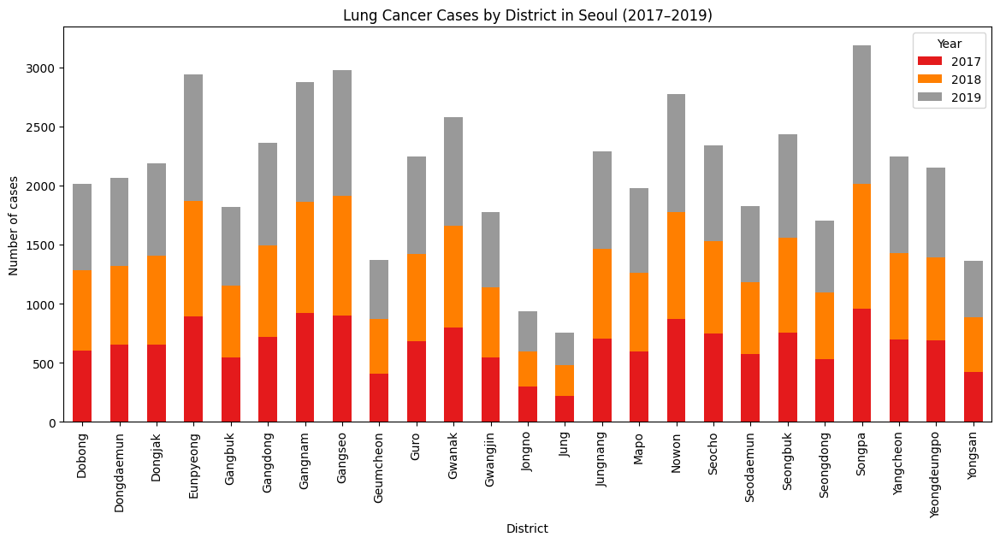

In [85]:
# Plot stacked bar chart
pivot_cases.plot(
    kind="bar", stacked=True, figsize=(14,6), cmap="Set1"
)
plt.title("Lung Cancer Cases by District in Seoul (2017–2019)")
plt.xlabel("District")
plt.ylabel("Number of cases")
plt.legend(title="Year")
plt.show()

## 5.4. Correlation Analysis

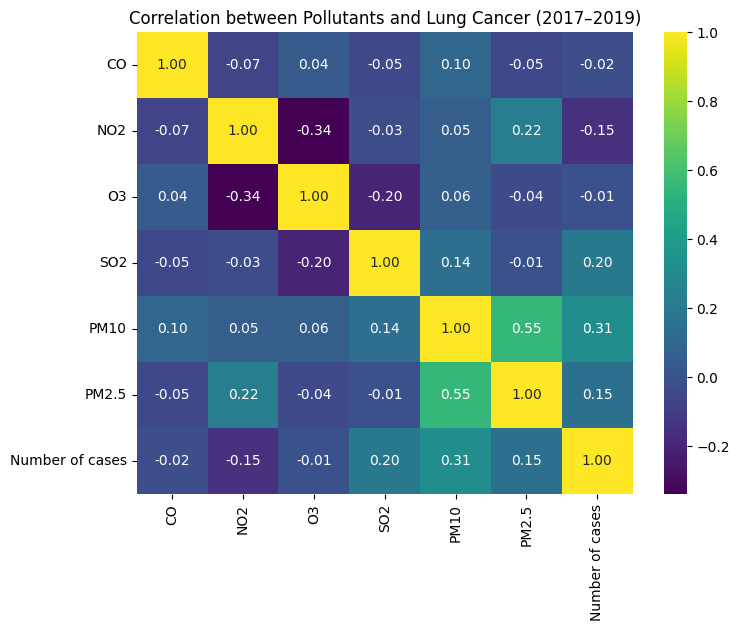

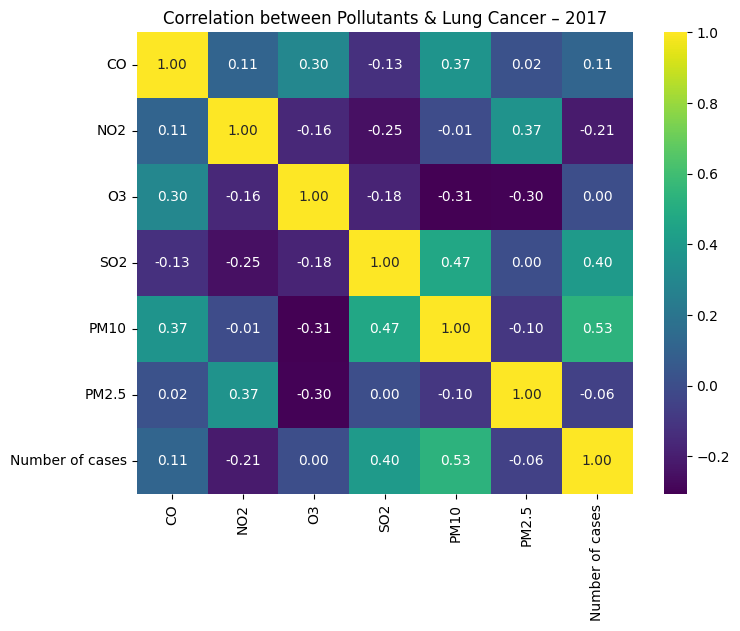

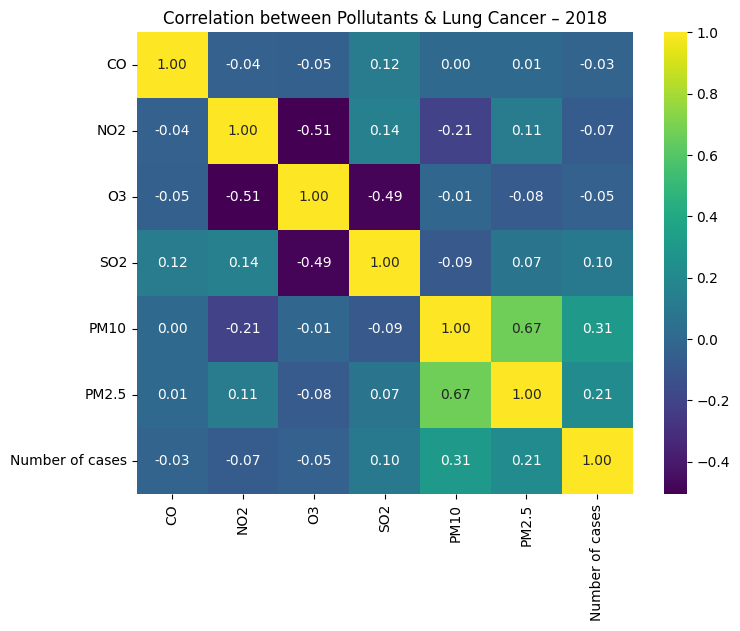

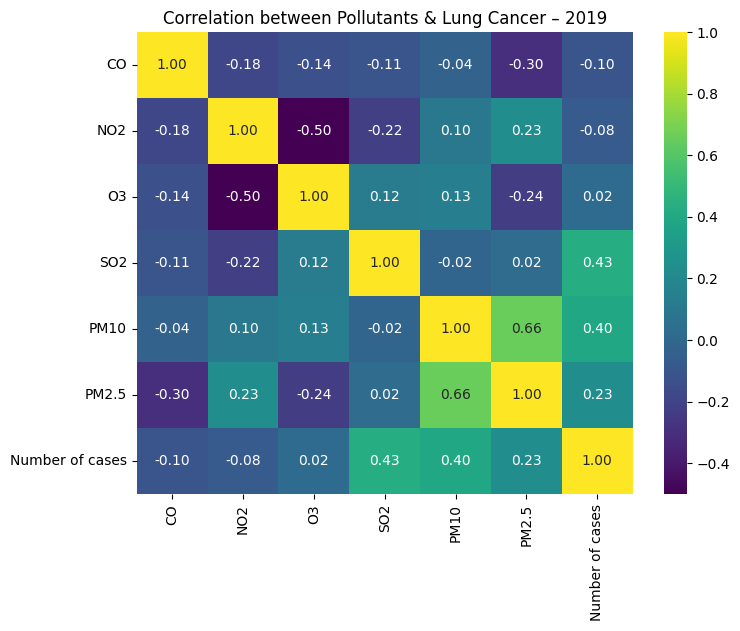

In [86]:
# Correlation matrix (all years)
corr_all = air_to_cancer[pollutants + ["Number of cases"]].corr()

plt.figure(figsize=(8,6))
sns.heatmap(corr_all, annot=True, cmap="viridis", fmt=".2f")
plt.title("Correlation between Pollutants and Lung Cancer (2017–2019)")
plt.show()

# Correlation by year
for yr in air_to_cancer['year'].unique():
    corr = air_to_cancer[air_to_cancer['year']==yr][pollutants+["Number of cases"]].corr()
    plt.figure(figsize=(8,6))
    sns.heatmap(corr,annot=True, cmap="viridis", fmt=".2f")
    plt.title(f"Correlation between Pollutants & Lung Cancer – {yr}")
    plt.show()

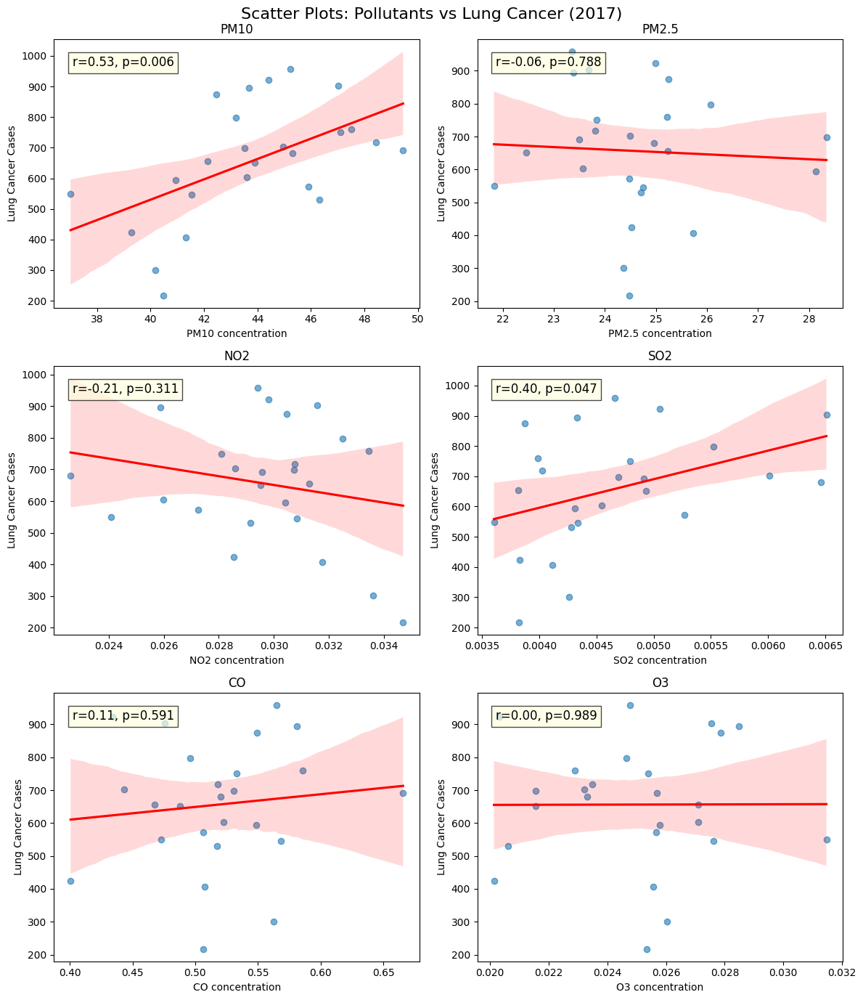

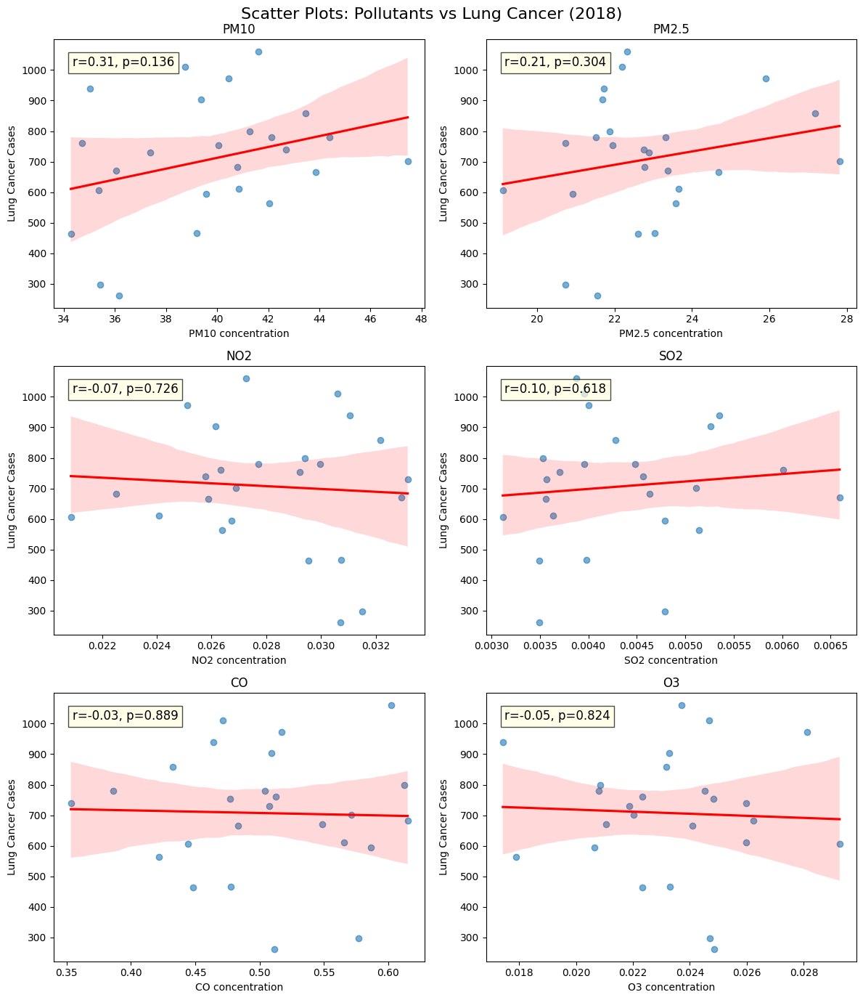

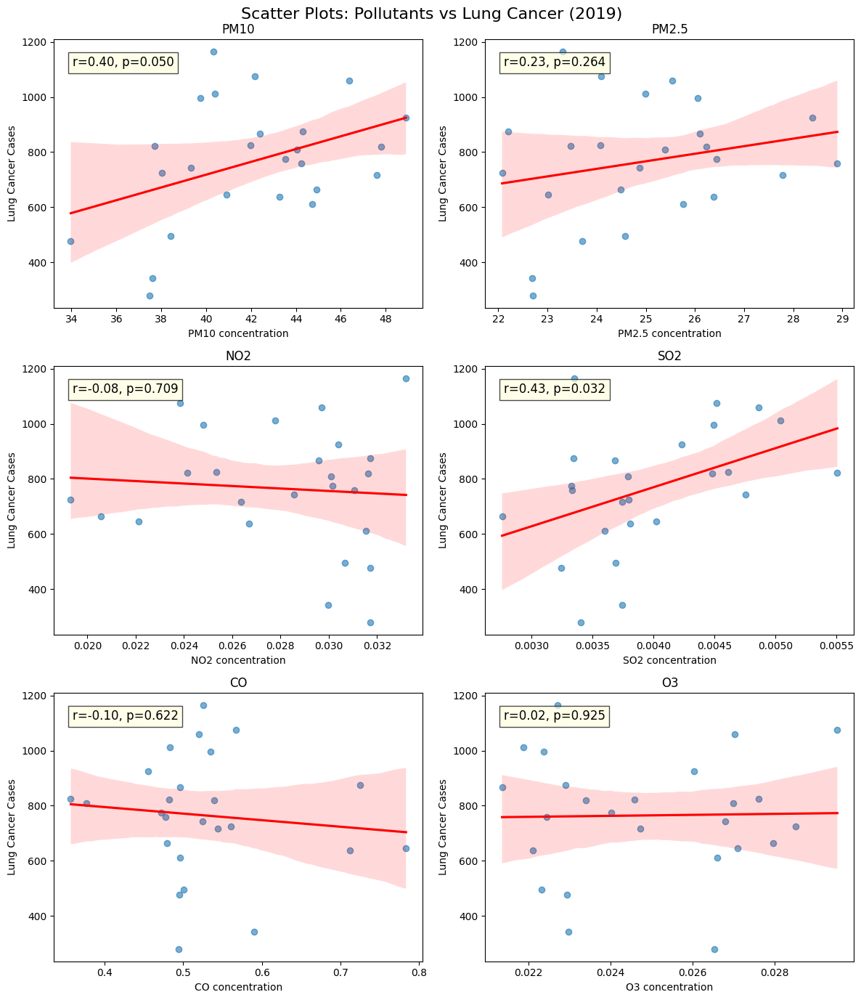

In [87]:
pollutants = ["PM10", "PM2.5", "NO2", "SO2", "CO", "O3"]

# change to numeric
for col in pollutants + ["Number of cases"]:
    air_to_cancer[col] = pd.to_numeric(air_to_cancer[col], errors="coerce")

# loop over year
for yr in sorted(air_to_cancer["year"].unique()):
    df_year = air_to_cancer[air_to_cancer["year"] == yr]

    fig, axes = plt.subplots(3, 2, figsize=(12, 14))
    axes = axes.flatten()

    for i, pol in enumerate(pollutants):
        ax = axes[i]

        sns.regplot(
            data=df_year,
            x=pol, y="Number of cases",
            scatter_kws={"alpha":0.6},
            line_kws={"color":"red"},
            ax=ax
        )

        # calculate Pearson r and p-value
        r, p = pearsonr(df_year[pol], df_year["Number of cases"])

        # note r and p
        ax.text(
            0.05, 0.9,
            f"r={r:.2f}, p={p:.3f}",
            transform=ax.transAxes,
            fontsize=12,
            bbox=dict(fc="lightyellow", ec="black", alpha=0.7)
        )

        ax.set_title(f"{pol}", fontsize=12)
        ax.set_xlabel(f"{pol} concentration")
        ax.set_ylabel("Lung Cancer Cases")

    fig.suptitle(f"Scatter Plots: Pollutants vs Lung Cancer ({yr})", fontsize=16)
    plt.tight_layout()
    plt.show()

## 5.5 Multiple Regression Analysis

In [88]:
pollutants = ["CO","NO2","O3", "SO2", "PM10","PM2.5"]

X = air_to_cancer[pollutants].copy()
y = air_to_cancer["Number of cases"].astype(float)

# Standardize predictors to compare coefficients
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)
X_scaled = pd.DataFrame(X_scaled, columns=pollutants)

# OLS (statsmodels)
X_const = sm.add_constant(X_scaled)
ols_model = sm.OLS(y, X_const).fit()
print(ols_model.summary())

                            OLS Regression Results                            
Dep. Variable:        Number of cases   R-squared:                       0.153
Model:                            OLS   Adj. R-squared:                  0.079
Method:                 Least Squares   F-statistic:                     2.055
Date:                Sun, 14 Sep 2025   Prob (F-statistic):             0.0701
Time:                        16:38:46   Log-Likelihood:                -499.25
No. Observations:                  75   AIC:                             1012.
Df Residuals:                      68   BIC:                             1029.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const        709.3467     22.828     31.074      0.0

In [89]:
# VIF Multicollinearity Check
X_const = add_constant(air_to_cancer[pollutants])
vif_data = pd.DataFrame()
vif_data["Variable"] = X_const.columns
vif_data["VIF"] = [variance_inflation_factor(X_const.values, i)
                  for i in range(X_const.shape[1])]
print("\nVariance Inflation Factor check: \n", vif_data)


Variance Inflation Factor check: 
   Variable         VIF
0    const  477.379486
1       CO    1.033661
2      NO2    1.209731
3       O3    1.211762
4      SO2    1.102070
5     PM10    1.546106
6    PM2.5    1.553792


In [90]:
# Ridge Regression Coeff
ridge = RidgeCV(alphas=np.logspace(-3,5,50), cv=5).fit(X_scaled, y)
ridge_coefs = pd.Series(ridge.coef_, index=pollutants).sort_values(key=abs, ascending=False)
print("\nRidge coefficients:\n", ridge_coefs)
print("\nBest alpha (Ridge):", ridge.alpha_)


Ridge coefficients:
 PM10     2.826832
SO2      1.808087
NO2     -1.359720
PM2.5    1.299330
CO      -0.174069
O3      -0.083054
dtype: float64

Best alpha (Ridge): 1599.8587196060573


In [91]:
# Lasso Regression Coeff
lasso = LassoCV(alphas=np.logspace(-3,5,50), cv=5, random_state=42).fit(X_scaled, y)
lasso_coefs = pd.Series(lasso.coef_, index=pollutants).sort_values(key=abs, ascending=False)
print("\nLasso coefficients:\n", lasso_coefs)
print("\nBest alpha (Lasso):", lasso.alpha_)


Lasso coefficients:
 PM10     9.710993
CO      -0.000000
NO2     -0.000000
O3      -0.000000
SO2      0.000000
PM2.5    0.000000
dtype: float64

Best alpha (Lasso): 54.286754393238596


In [92]:
# OLS Regression Coeff
ols_coefs = pd.Series(ols_model.params[1:], index=pollutants).sort_values(key=abs, ascending=False)
print("\nOLS standardized coefficients:\n", ols_coefs)


OLS standardized coefficients:
 PM10     61.643583
NO2     -38.249026
SO2      28.222930
O3      -12.192909
CO      -10.311125
PM2.5     4.112966
dtype: float64


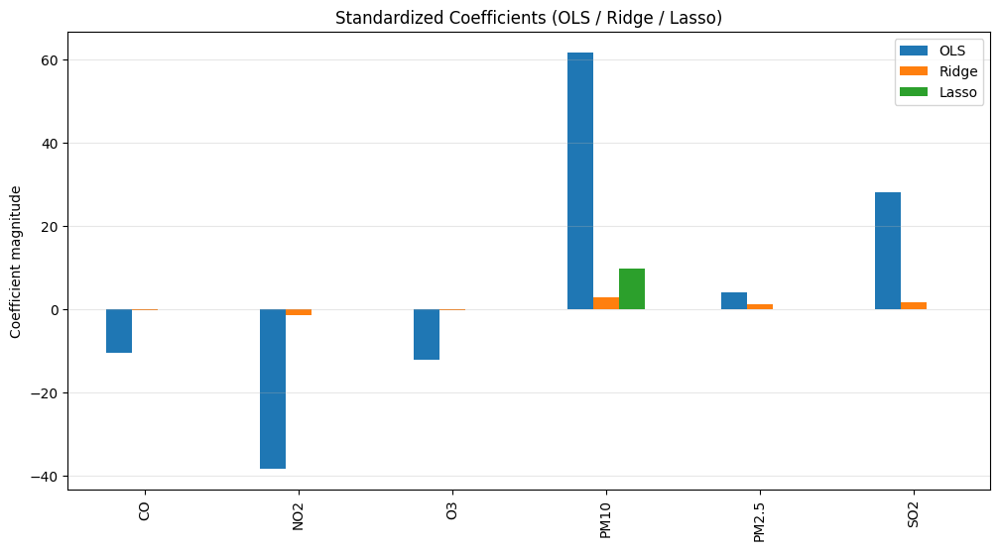

In [93]:
# Visualization
coef_df = pd.DataFrame({
    "OLS": ols_coefs,
    "Ridge": ridge_coefs,
    "Lasso": lasso_coefs
})

coef_df.plot(kind="bar", figsize=(12,6))
plt.title("Standardized Coefficients (OLS / Ridge / Lasso)")
plt.ylabel("Coefficient magnitude")
plt.grid(axis="y", alpha=0.3)
plt.show()

## 5.6. Time-lag Analysis

In [94]:
lung_cancer_with2020 = df[['district','2017','2018','2019', '2020']].melt(
    id_vars="district", var_name="year", value_name="Number of cases"
)
lung_cancer_with2020["year"] = lung_cancer_with2020["year"].astype(int)

lung_cancer_with2020

,district,year,Number of cases
0,Jongno,2017,301
1,Jung,2017,217
2,Yongsan,2017,424
3,Seongdong,2017,531
4,Gwangjin,2017,546
...,...,...,...
95,Gwanak,2020,976
96,Seocho,2020,812
97,Gangnam,2020,1070
98,Songpa,2020,1198


In [95]:
lag_df = air_to_cancer.copy()

# Create cancer version with year shifted by -1 to match pollution with same year
cancer_shifted = lung_cancer_with2020.copy()
cancer_shifted["year"] = cancer_shifted["year"] - 1
cancer_shifted = cancer_shifted.rename(columns={"Number of cases":"Cancer_next_year"})

# Merge pollution year t với cancer year t+1
lagged_merge = pd.merge(
    air_annual,
    cancer_shifted,
    on=["district","year"],
    how="inner"
)

lagged_merge

,district,year,CO,NO2,O3,SO2,PM10,PM2.5,Cancer_next_year
0,Dobong,2017,0.522510,0.025971,0.027104,0.004547,43.599368,23.565274,683
1,Dobong,2018,0.615067,0.022520,0.026234,0.004629,40.799198,22.772156,726
2,Dobong,2019,0.560990,0.019313,0.028520,0.003800,38.025431,22.076876,721
3,Dongdaemun,2017,0.487923,0.029507,0.021544,0.004932,43.897026,22.458704,670
4,Dongdaemun,2018,0.548455,0.032926,0.021058,0.006594,36.034884,23.369397,743
...,...,...,...,...,...,...,...,...,...
70,Yeongdeungpo,2018,0.571228,0.026903,0.022021,0.005109,47.462289,27.810503,758
71,Yeongdeungpo,2019,0.477713,0.031057,0.022438,0.003331,44.245525,28.896461,809
72,Yongsan,2017,0.400656,0.028549,0.020132,0.003834,39.276830,24.526413,465
73,Yongsan,2018,0.448193,0.029546,0.022320,0.003497,34.270234,22.597017,478


In [96]:
# Correlation matrix (pollutants vs Cancer_next_year)
corr_lagged = lagged_merge[pollutants + ["Cancer_next_year"]].corr()
print("\nCorrelation with 1-year lag")
print(corr_lagged["Cancer_next_year"].sort_values(ascending=False))


Correlation with 1-year lag
Cancer_next_year    1.000000
PM10                0.306133
SO2                 0.231159
PM2.5               0.135804
O3                 -0.012134
CO                 -0.033744
NO2                -0.144080
Name: Cancer_next_year, dtype: float64


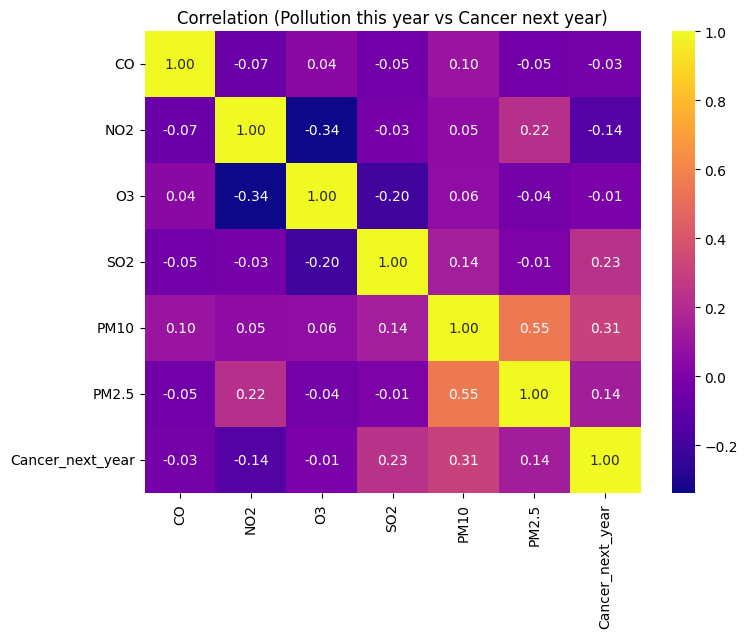

In [97]:
# Correlation matrix (pollutants vs Cancer_next_year)
corr_lagged = lagged_merge[pollutants + ["Cancer_next_year"]].corr()

# Heatmap visualization
plt.figure(figsize=(8,6))
sns.heatmap(corr_lagged, annot=True, cmap="plasma", fmt=".2f")
plt.title("Correlation (Pollution this year vs Cancer next year)")
plt.show()

In [98]:
# Corr same-year
corr_same = air_to_cancer[pollutants + ["Number of cases"]].corr()["Number of cases"].drop("Number of cases")

# Corr lag-1
corr_lagged = lagged_merge[pollutants + ["Cancer_next_year"]].corr()["Cancer_next_year"].drop("Cancer_next_year")

# Merge to compare
compare_corr = pd.DataFrame({
    "Pollutant": pollutants,
    "Same year": corr_same.values,
    "Lag-1 year": corr_lagged.values
})

compare_corr

,Pollutant,Same year,Lag-1 year
0,CO,-0.017950,-0.033744
1,NO2,-0.146299,-0.144080
2,O3,-0.008016,-0.012134
3,SO2,0.199541,0.231159
4,PM10,0.312801,0.306133
5,PM2.5,0.147941,0.135804


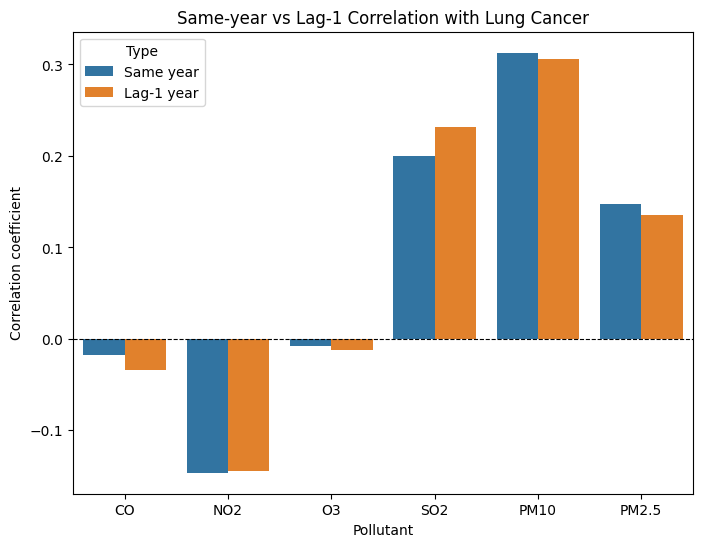

In [99]:
# Bar chart visualization
plt.figure(figsize=(8,6))
sns.barplot(
    data=compare_corr.melt(id_vars="Pollutant", var_name="Type", value_name="Correlation"),
    x="Pollutant", y="Correlation", hue="Type"
)

plt.axhline(0, color="black", linewidth=0.8, linestyle="--")
plt.title("Same-year vs Lag-1 Correlation with Lung Cancer")
plt.ylabel("Correlation coefficient")

plt.show()

## 5.7. Clustering Districts by Pollutants and Lung Cancer Cases

In [100]:
# Convert all columns to numeric
for col in pollutants + ["Number of cases"]:
    air_to_cancer[col] = pd.to_numeric(air_to_cancer[col], errors='coerce')

# Calculate three-year average
cluster_df = (
    air_to_cancer.groupby("district")[pollutants + ["Number of cases"]]
    .mean()
    .reset_index()
)

In [101]:
scalers = {
    "StandardScaler": StandardScaler(),
    "MinMaxScaler": MinMaxScaler(),
    "RobustScaler": RobustScaler()
}

for scaler_name, scaler in scalers.items():
    print(f"\n=== {scaler_name} ===")
    X_scaled = scaler.fit_transform(cluster_df[pollutants + ["Number of cases"]])
    for k in range(2, 6):
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10).fit(X_scaled)
        sil = silhouette_score(X_scaled, kmeans.labels_)
        print(f"k={k}, silhouette={sil:.3f}")



=== StandardScaler ===
k=2, silhouette=0.166
k=3, silhouette=0.206
k=4, silhouette=0.232
k=5, silhouette=0.242

=== MinMaxScaler ===
k=2, silhouette=0.177
k=3, silhouette=0.232
k=4, silhouette=0.230
k=5, silhouette=0.236

=== RobustScaler ===
k=2, silhouette=0.169
k=3, silhouette=0.221
k=4, silhouette=0.238
k=5, silhouette=0.235


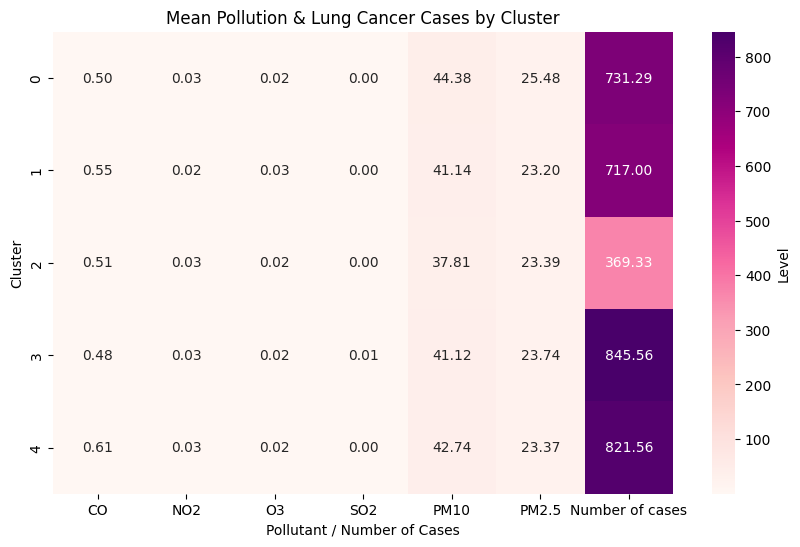

In [102]:
# Standardize
scaler = StandardScaler()
X_scaled = scaler.fit_transform(cluster_df[pollutants + ["Number of cases"]])

# KMeans clustering
kmeans = KMeans(n_clusters=5, random_state=42, n_init=10)
cluster_df["Cluster"] = kmeans.fit_predict(X_scaled)

# Visualize
cluster_means = cluster_df.groupby("Cluster")[pollutants + ["Number of cases"]].mean()
plt.figure(figsize=(10,6))
sns.heatmap(cluster_means, annot=True, fmt=".2f", cmap="RdPu", cbar_kws={'label': 'Level'})
plt.title("Mean Pollution & Lung Cancer Cases by Cluster")
plt.ylabel("Cluster")
plt.xlabel("Pollutant / Number of Cases")
plt.show()

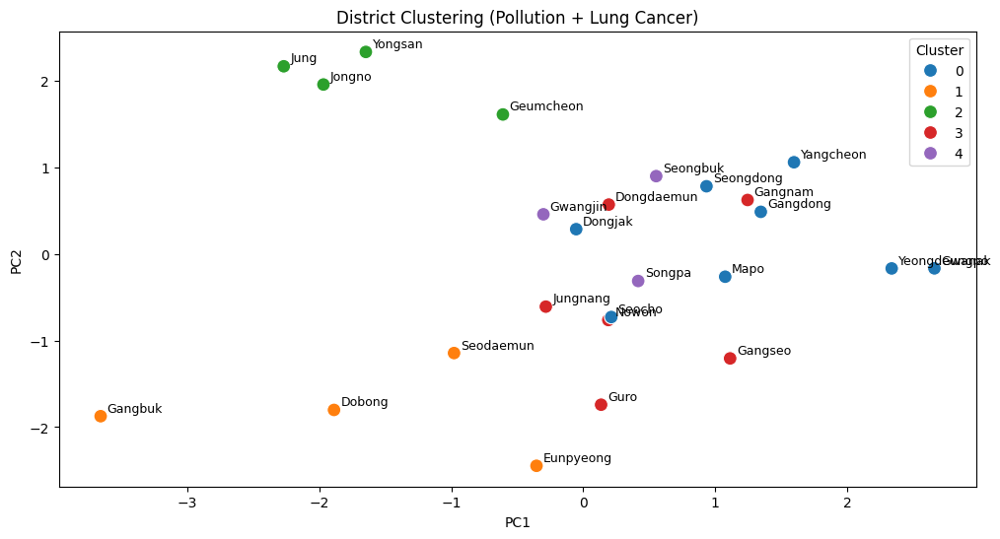

In [103]:
# PCA 2D
pca = PCA(n_components=2)
proj = pca.fit_transform(X_scaled)

plt.figure(figsize=(12,6))
sns.scatterplot(x=proj[:,0], y=proj[:,1], hue=cluster_df["Cluster"],
                palette="tab10", s=100)
for i, txt in enumerate(cluster_df["district"]):
    plt.text(proj[i,0]+0.05, proj[i,1]+0.05, txt, fontsize=9)
plt.title("District Clustering (Pollution + Lung Cancer)")
plt.xlabel("PC1"); plt.ylabel("PC2")
plt.legend(title="Cluster")
plt.show()

# PART 6. FORECASTING POLLUTANTS

In [ ]:
df_ts = df_monthly.set_index("Measurement date")["PM2.5"]





## 6.1. LSTM Model

/tmp/ipython-input-1263581737.py:28: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 13ms/step
To reach R²=0.5, need MSE <= 101.367
To reach R²=0.7, need MSE <= 60.820
To reach R²=0.9, need MSE <= 20.273
MSE: 44.2568
RMSE: 6.6526
MAE: 4.5723
R² (sklearn): 0.7817
R² (from MSE): 0.7817
63/63 ━━━━━━━━━━━━━━━━━━━━ 1s 8ms/step - loss: 18.4089
Test Loss: 44.25679016113281
63/63 ━━━━━━━━━━━━━━━━━━━━ 0s 7ms/step
[[9.016169]
 [9.12192 ]
 [9.188193]
 [9.140037]
 [8.442285]]
Actual: 9.0, Predicted: 9.016168594360352
Actual: 9.0, Predicted: 9.121919631958008
Actual: 8.0, Predicted: 9.188193321228027
Actual: 4.0, Predicted: 9.140036582946777
Actual: 12.0, Predicted: 8.44228458404541
MSE: 44.256787437279314
RMSE: 6.652577503289932
MAE: 4.572304969321272
R²: 0.7817007049257024


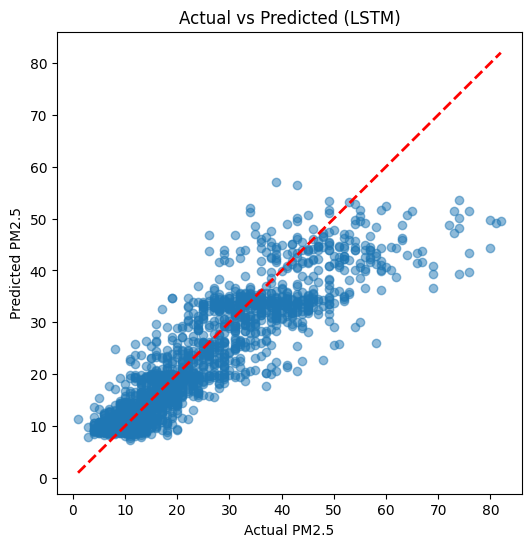

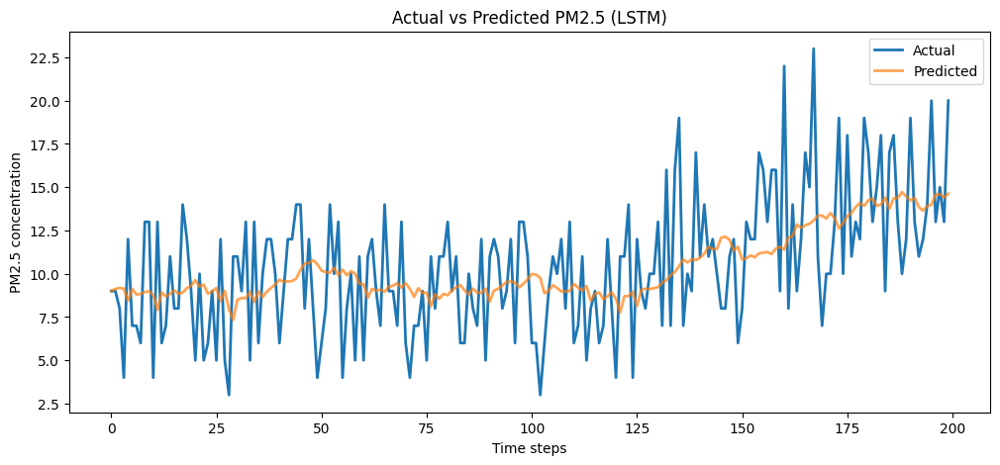

In [ ]:
import numpy as np
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense, Dropout
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

def create_sequences(series, window=12):
    X, y = [], []
    for i in range(len(series) - window):
        X.append(series[i:i+window])
        y.append(series[i+window])
    return np.array(X), np.array(y)

df_wide['Measurement date'] = pd.to_datetime(df_wide['Measurement date'])
df_wide = df_wide.sort_values('Measurement date')
pm25_series = df_wide['PM2.5'].fillna(method='ffill').fillna(method='bfill').values

pm25_series = pm25_series[:10000]

window = 24
X, y = create_sequences(pm25_series, window)
X = X.reshape((X.shape[0], X.shape[1], 1))

split = int(len(X) * 0.8)
X_train, X_test = X[:split], X[split:]
y_train, y_test = y[:split], y[split:]


model = Sequential([
    LSTM(64, return_sequences=True, input_shape=(window,1)),
    Dropout(0.2),
    LSTM(32),
    Dense(1)
])
model.compile(optimizer="adam", loss="mse")


history = model.fit(
    X_train, y_train,
    validation_split=0.2,
    epochs=50,
    batch_size=20,
    verbose=0,
    shuffle=False
)

y_pred = model.predict(X_test)

mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)


n = len(y_test)
ss_tot = np.sum((y_test - y_test.mean())**2)
r2_from_mse = 1 - (mse * n) / ss_tot

targets = [0.5, 0.7, 0.9]
for t in targets:
    required_mse = (1 - t) * ss_tot / n
    print(f"To reach R²={t}, need MSE <= {required_mse:.3f}")


print(f"MSE: {mse:.4f}")
print(f"RMSE: {rmse:.4f}")
print(f"MAE: {mae:.4f}")
print(f"R² (sklearn): {r2:.4f}")
print(f"R² (from MSE): {r2_from_mse:.4f}")

loss = model.evaluate(X_test, y_test)
print("Test Loss:", loss)
predictions = model.predict(X_test)
print(predictions[:5])  # see first 5 predictions
for i in range(5):
    print(f"Actual: {y_test[i]}, Predicted: {predictions[i][0]}")

y_pred = predictions.flatten()
y_true = y_test.flatten()

mse = mean_squared_error(y_true, y_pred)
rmse = np.sqrt(mse)
mae = mean_absolute_error(y_true, y_pred)
r2 = r2_score(y_true, y_pred)

print("MSE:", mse)
print("RMSE:", rmse)
print("MAE:", mae)
print("R²:", r2)
import matplotlib.pyplot as plt

plt.figure(figsize=(6,6))
plt.scatter(y_true, y_pred, alpha=0.5)
plt.plot([y_true.min(), y_true.max()],
         [y_true.min(), y_true.max()],
         'r--', lw=2)  # 45-degree line
plt.xlabel("Actual PM2.5")
plt.ylabel("Predicted PM2.5")
plt.title("Actual vs Predicted (LSTM)")
plt.show()
plt.figure(figsize=(12,5))
plt.plot(y_true[:200], label="Actual", linewidth=2)
plt.plot(y_pred[:200], label="Predicted", linewidth=2, alpha=0.7)
plt.legend()
plt.xlabel("Time steps")
plt.ylabel("PM2.5 concentration")
plt.title("Actual vs Predicted PM2.5 (LSTM)")
plt.show()


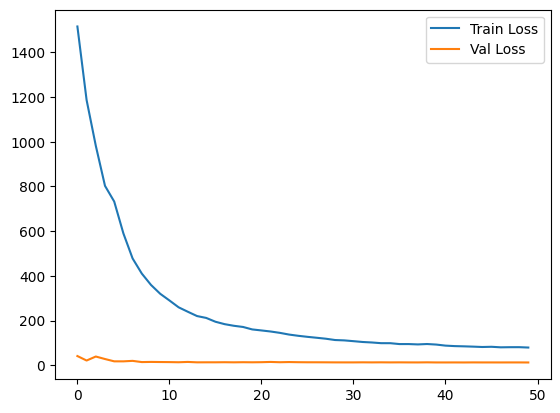

In [ ]:
plt.plot(history.history['loss'], label='Train Loss')
plt.plot(history.history['val_loss'], label='Val Loss')
plt.legend()
plt.show()

## 6.2. Baseline Models (Linear Regression & Random Forest)

Linear Regression -> MSE: 39.8453, RMSE: 6.3123, MAE: 4.4922, R²: 0.8034
Random Forest -> MSE: 40.6418, RMSE: 6.3751, MAE: 4.5163, R²: 0.7995


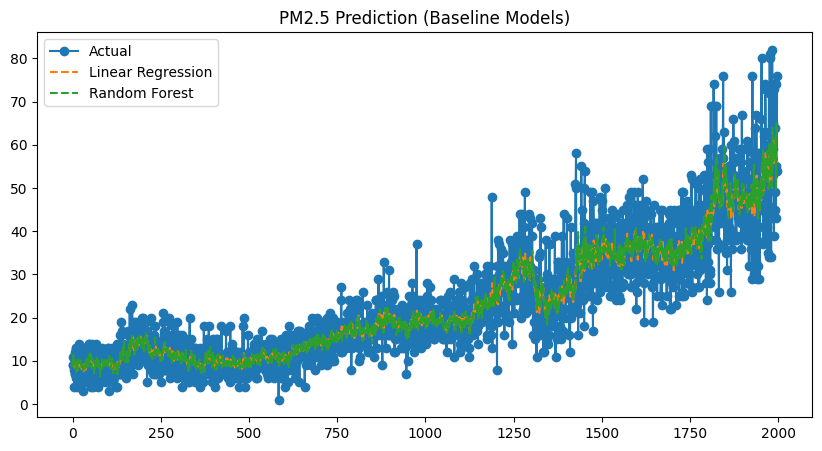

Actual: 11.00, LR Pred: 8.74, RF Pred: 8.67
Actual: 9.00, LR Pred: 9.70, RF Pred: 9.18
Actual: 9.00, LR Pred: 9.19, RF Pred: 11.42
Actual: 9.00, LR Pred: 8.89, RF Pred: 9.21
Actual: 8.00, LR Pred: 9.42, RF Pred: 9.46


In [ ]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from sklearn.preprocessing import StandardScaler
import matplotlib.pyplot as plt


pm25_values = pm25_series

window = 12
X, y = create_sequences(pm25_values, window=window)

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

split_idx = int(len(X_scaled) * 0.8)
X_train, X_test = X_scaled[:split_idx], X_scaled[split_idx:]
y_train, y_test = y[:split_idx], y[split_idx:]

lin_reg = LinearRegression()
lin_reg.fit(X_train, y_train)
y_pred_lr = lin_reg.predict(X_test)

rf = RandomForestRegressor(n_estimators=200, random_state=42)
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)

def evaluate_model(name, y_true, y_pred):
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_true, y_pred)
    r2 = r2_score(y_true, y_pred)
    print(f"{name} -> MSE: {mse:.4f}, RMSE: {rmse:.4f}, MAE: {mae:.4f}, R²: {r2:.4f}")
    return y_pred

y_pred_lr = evaluate_model("Linear Regression", y_test, y_pred_lr)
y_pred_rf = evaluate_model("Random Forest", y_test, y_pred_rf)

plt.figure(figsize=(10,5))
plt.plot(y_test, label="Actual", marker="o")
plt.plot(y_pred_lr, label="Linear Regression", linestyle="--")
plt.plot(y_pred_rf, label="Random Forest", linestyle="--")
plt.legend()
plt.title("PM2.5 Prediction (Baseline Models)")
plt.show()

for i in range(5):
    print(f"Actual: {y_test[i]:.2f}, LR Pred: {y_pred_lr[i]:.2f}, RF Pred: {y_pred_rf[i]:.2f}")
